## Import das bibliotecas utilizadas


In [5]:
import pandas as pd
import numpy as np
import openpyxl

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from statistics import multimode


### Carrega Arquivo para EDA complementar

In [15]:
df_transpose_copy_graph = pd.read_csv(r'Projeto/Data/Output/df_transposed_copy_inputting_v19.csv')
df_transpose_copy_graph.head(5)

,year,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Aruba,...,Emerging and Developing Europe,Emerging market and developing economies,Euro area,European Union,Latin America and the Caribbean,Major advanced economies (G7),Middle East and Central Asia,Other advanced economies,Sub-Saharan Africa,World
0,1980-01-01,4.345486,2.7,-5.4,2.877381,2.4,8.2,0.7,5.290000,5.399885,...,-0.8,3.3,3.988678,1.8,6.4,0.9,-1.9,3.8,3.991920,2.1
1,1981-01-01,7.200000,5.7,3.0,0.385714,-4.4,3.8,-5.7,3.798462,-3.624698,...,-0.5,1.9,1.792949,0.1,0.9,2.0,-0.2,4.2,4.567689,1.9
2,1982-01-01,5.116667,2.9,6.4,0.371429,0.0,-0.1,-3.1,2.306923,4.538833,...,1.4,1.5,5.395555,0.6,-0.5,-0.1,0.4,2.2,8.037341,0.7
3,1983-01-01,4.283333,1.1,5.4,1.471429,4.2,5.4,3.7,0.815385,1.930603,...,4.6,1.8,4.752000,1.7,-2.8,3.3,0.7,4.0,3.300508,2.6
4,1984-01-01,6.166667,2.0,5.6,2.585714,6.0,10.2,2.0,-0.676154,-15.680825,...,4.1,4.1,-0.599934,2.5,3.9,5.0,0.3,6.6,5.023940,4.6


In [16]:
df_transpose_copy_graph['year'] = pd.to_datetime(df_transpose_copy_graph['year'], format='ISO8601')


In [17]:
df_transpose_copy_graph.set_index('year', inplace = True)
df_transpose_copy_graph.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 49 entries, 1980-01-01 to 2028-01-01
Columns: 228 entries, Afghanistan to World
dtypes: float64(228)
memory usage: 87.7 KB


In [18]:
df_transpose_copy_graph.head(5)

,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Aruba,Australia,...,Emerging and Developing Europe,Emerging market and developing economies,Euro area,European Union,Latin America and the Caribbean,Major advanced economies (G7),Middle East and Central Asia,Other advanced economies,Sub-Saharan Africa,World
year,,,,,,,,,,,,,,,,,,,,,
1980-01-01,4.345486,2.7,-5.4,2.877381,2.4,8.2,0.7,5.290000,5.399885,2.9,...,-0.8,3.3,3.988678,1.8,6.4,0.9,-1.9,3.8,3.991920,2.1
1981-01-01,7.200000,5.7,3.0,0.385714,-4.4,3.8,-5.7,3.798462,-3.624698,4.1,...,-0.5,1.9,1.792949,0.1,0.9,2.0,-0.2,4.2,4.567689,1.9
1982-01-01,5.116667,2.9,6.4,0.371429,0.0,-0.1,-3.1,2.306923,4.538833,0.1,...,1.4,1.5,5.395555,0.6,-0.5,-0.1,0.4,2.2,8.037341,0.7
1983-01-01,4.283333,1.1,5.4,1.471429,4.2,5.4,3.7,0.815385,1.930603,-0.5,...,4.6,1.8,4.752000,1.7,-2.8,3.3,0.7,4.0,3.300508,2.6
1984-01-01,6.166667,2.0,5.6,2.585714,6.0,10.2,2.0,-0.676154,-15.680825,6.3,...,4.1,4.1,-0.599934,2.5,3.9,5.0,0.3,6.6,5.023940,4.6


### Gerando grupo para análises

In [7]:
groups3 = {
    "africa": ["Africa (Region)"],
    "asia_and_pacific": ["Asia and Pacific"],
    "australia_nz": ["Australia and New Zealand"],
    "caribbean": ["Caribbean"],
    "central_america": ["Central America"],
    "central_asia_caucasus": ["Central Asia and the Caucasus"],
    "east_asia": ["East Asia"],
    "eastern_europe": ["Eastern Europe "],
    "europe": ["Europe"],
    "middle_east": ["Middle East (Region)"],
    "north_africa": ["North Africa"],
    "north_america": ["North America"],
    "pacific_islands": ["Pacific Islands "],
    "south_america": ["South America"],
    "south_asia": ["South Asia"],
    "southeast_asia": ["Southeast Asia"],
    "subsaharan_africa_region": ["Sub-Saharan Africa (Region) "],
    "western_europe": ["Western Europe"],
    "western_hemisphere": ["Western Hemisphere (Region)"],
    "asean_5": ["ASEAN-5"],
    "advanced_economies": ["Advanced economies"],
    "emerging_and_developing_asia": ["Emerging and Developing Asia"],
    "emerging_and_developing_europe": ["Emerging and Developing Europe"],
    "emerging_market_and_developing_economies": ["Emerging market and developing economies"],
    "euro_area": ["Euro area"],
    "european_union": ["European Union"],
    "latin_america_and_the_caribbean": ["Latin America and the Caribbean"],
    "major_advanced_economies_(g7)": ["Major advanced economies (G7)"],
    "middle_east_and_central_asia": ["Middle East and Central Asia"],
    "other_advanced_economies": ["Other advanced economies"],
    "sub-saharan_africa": ["Sub-Saharan Africa"],
    "world": ["World"]
}


### Gerando os graficos temporais dos grupos

#### Ver gráficos de todos os grupos após inputação dos dados

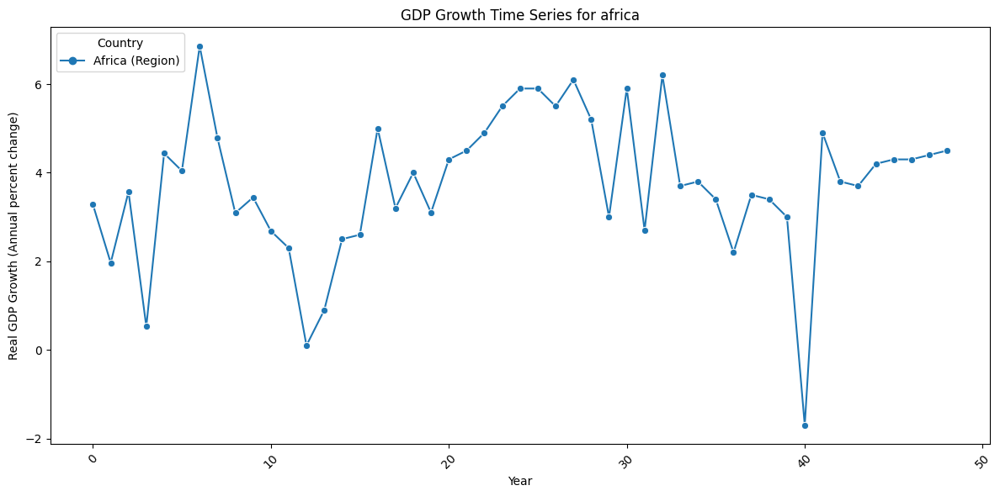

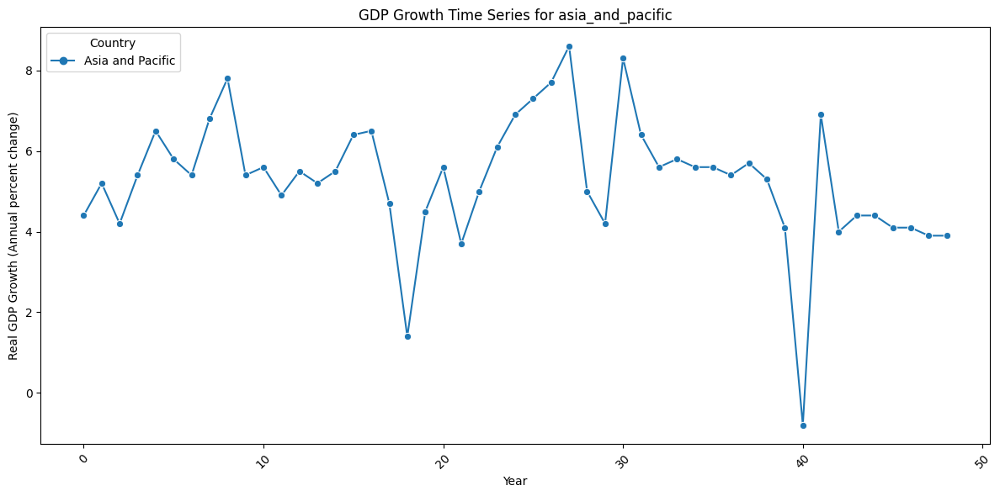

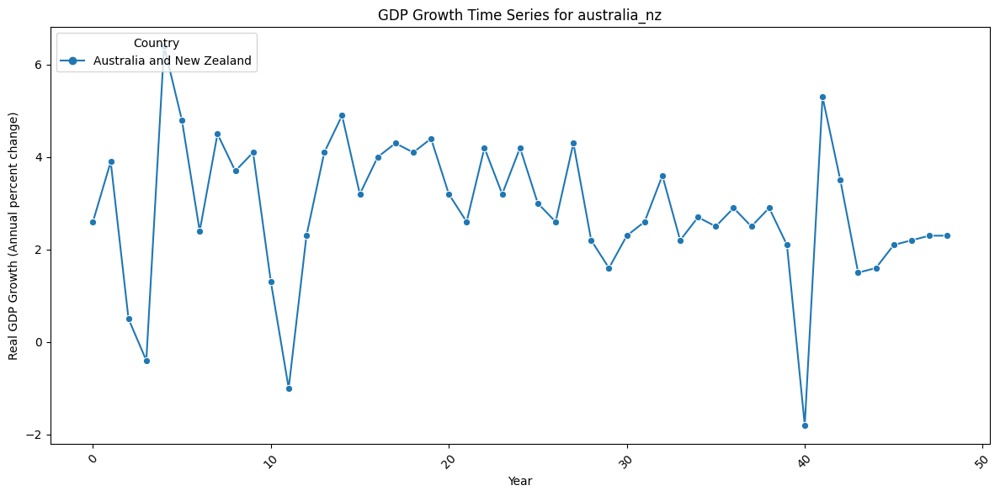

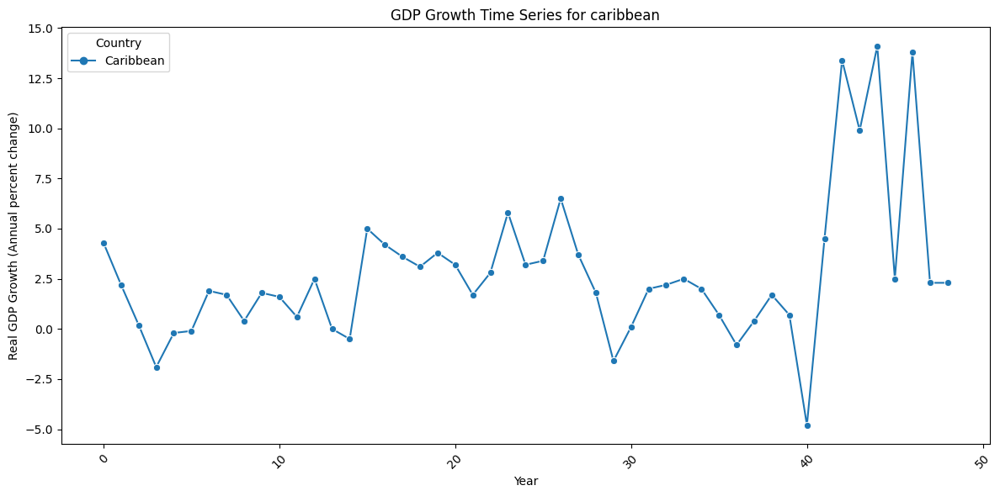

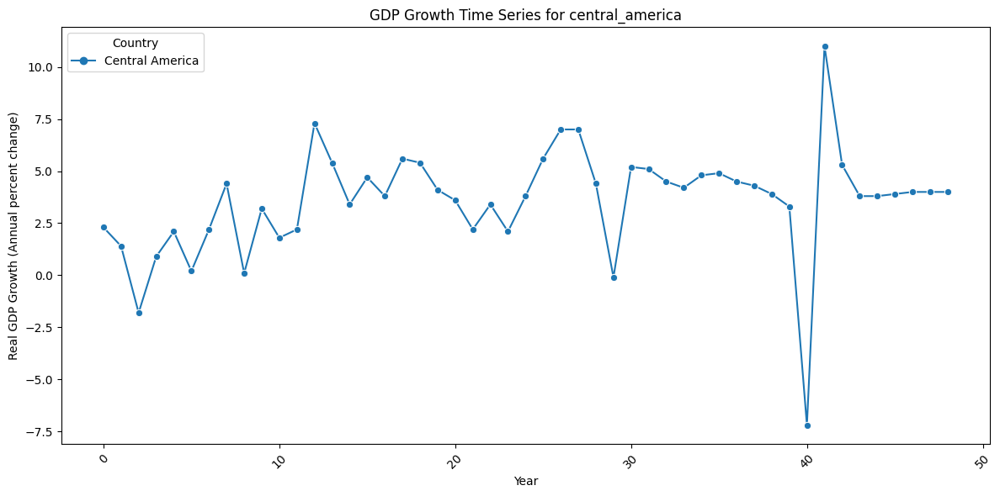

...

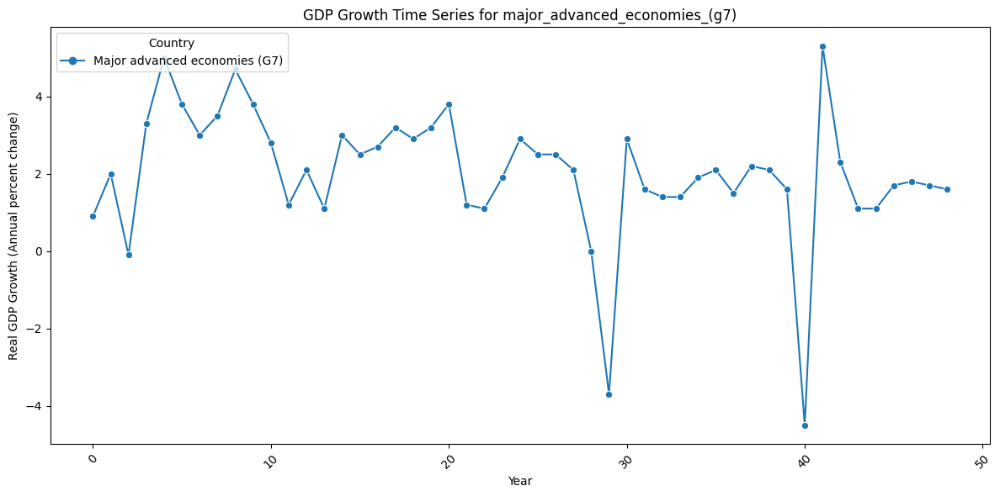

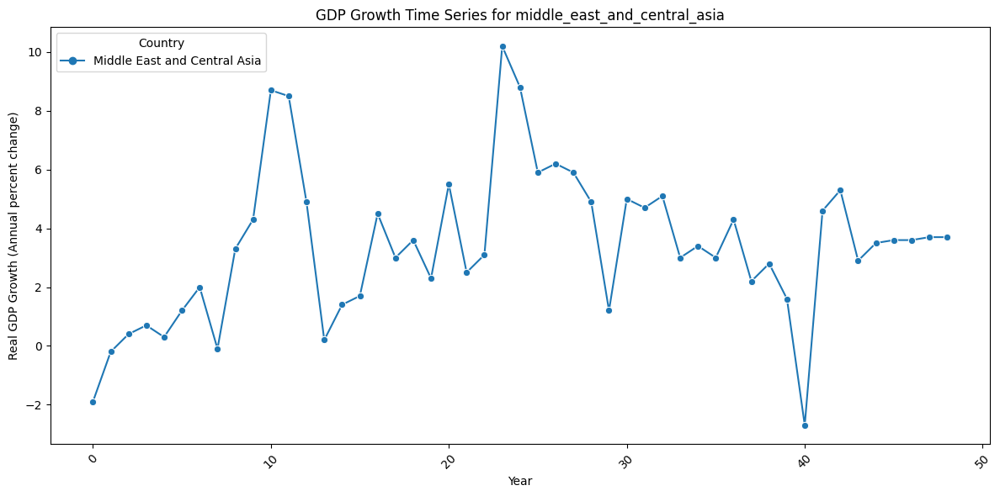

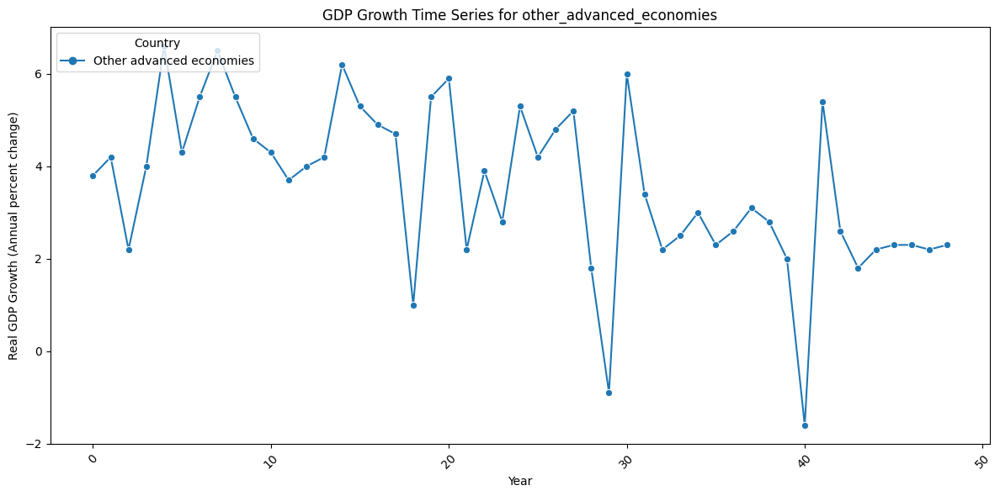

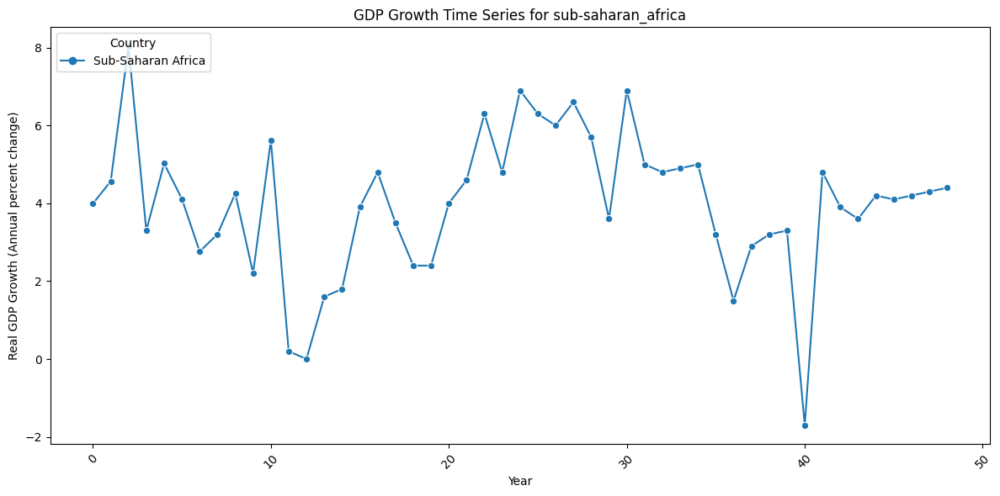

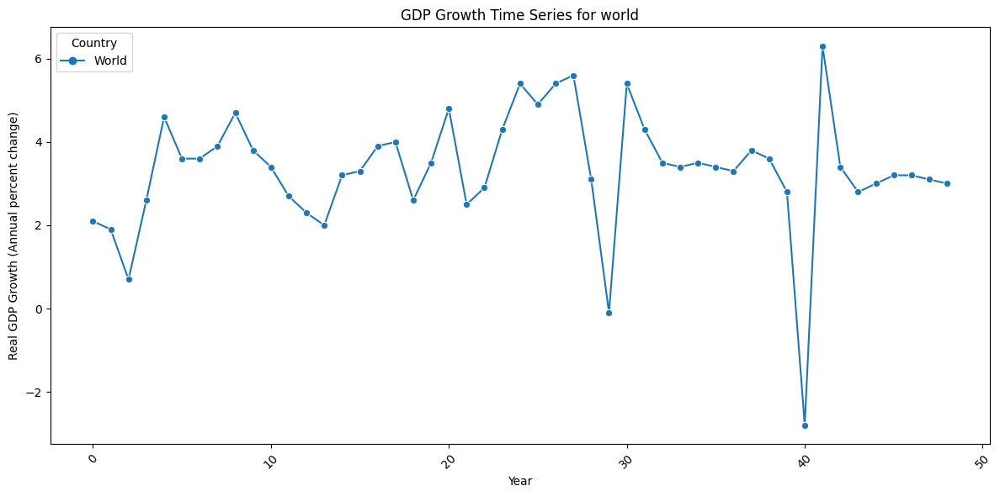

In [8]:

# Loop through the groups and plot the data
for group_name, country_list in groups3.items():
    # Filter the DataFrame to include only the selected countries
    group_data = df_transpose_copy_graph[country_list]

    # Plot the time series using Seaborn
    plt.figure(figsize=(12, 6))
    sns.lineplot(data=group_data, markers=True)
    plt.title(f"GDP Growth Time Series for {group_name}")
    plt.xlabel("Year")
    plt.ylabel("Real GDP Growth (Annual percent change)")

    plt.xticks(rotation=45)
    plt.tight_layout()

    plt.legend(loc='upper left', title="Country")
    plt.show()


### EDA complementar - Decomposição da Série Temporal

#### Aplicando o método .decompose()

Os gráficos de tendência e sazonalidade mostraram uma linha reta no eixo zero. Isso sugere que não há padrões significativos de tendência ou sazonalidade na série temporal:
- Tendência: A linha reta no eixo zero indica que não há uma direção consistente de crescimento ou decrescimento na série temporal, sugerindo que a série não apresenta uma tendência obvia, seja ela ascendente ou descedente ou horizontal.
- Sazonalidade: A linha reta no eixo zero sugere que não existem padrões sazonais evidentes na série temporal, não exibindo variações regulares que se repetem em intervalos fixos como sazonalidade mensal ou anual. 

In [9]:
df_transposed_copy_inputting_v19 = pd.read_excel(r'Projeto/Data/Output/df_transposed_copy_inputting_v19.csv',sheet_name='NGDP_RPCH')
df_transpose_copy_decompose = df_transposed_copy_inputting_v19.copy()


ValueError: Excel file format cannot be determined, you must specify an engine manually.

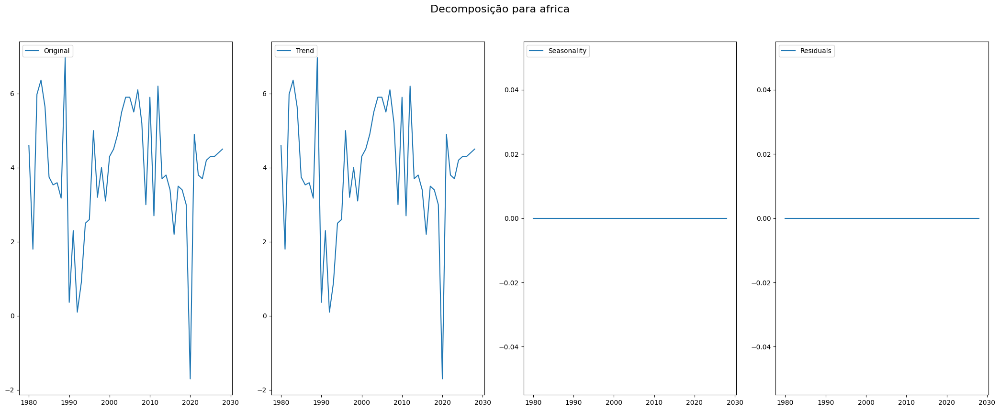

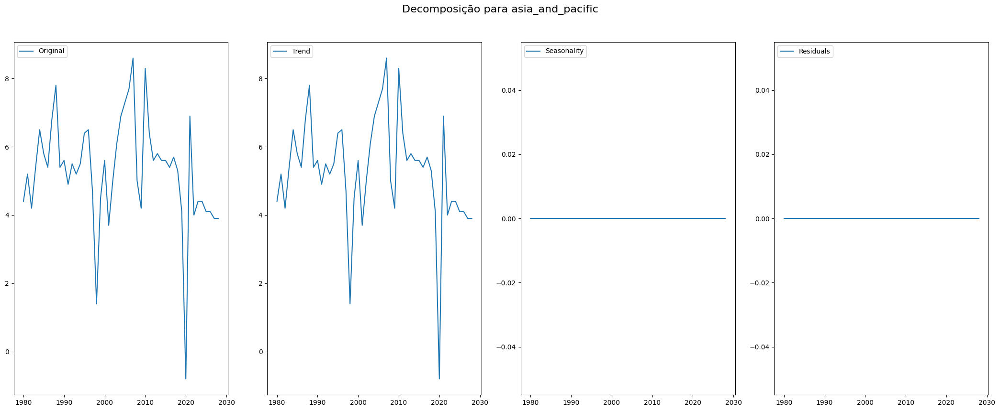

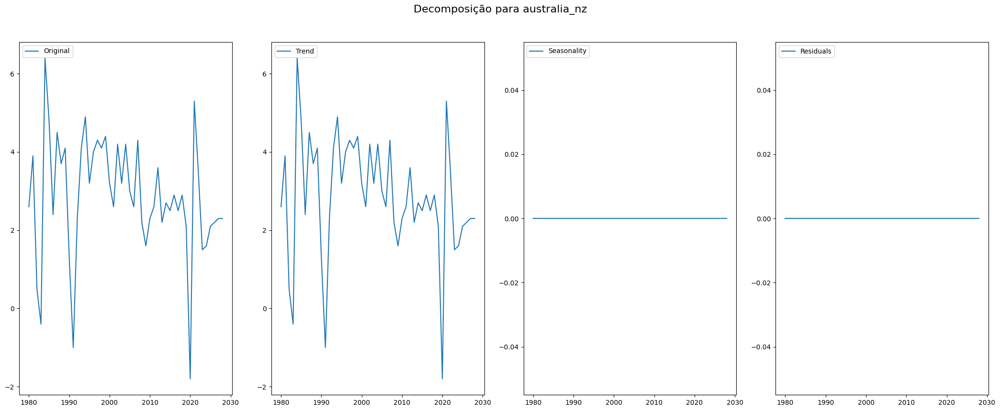

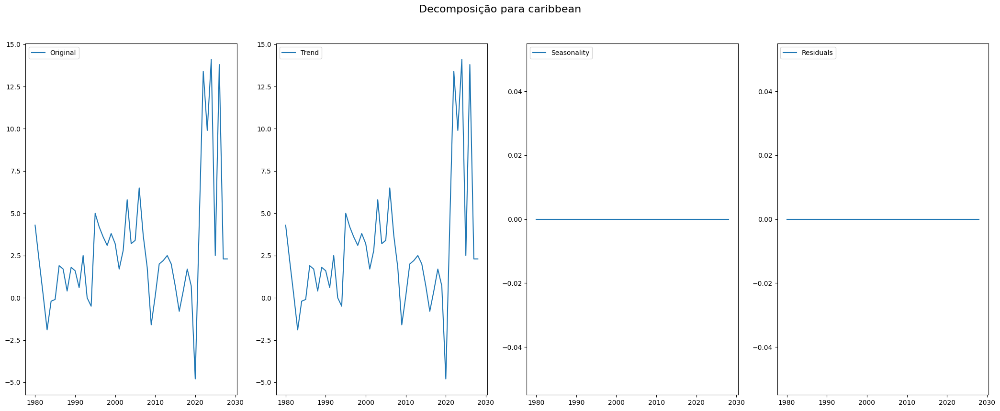

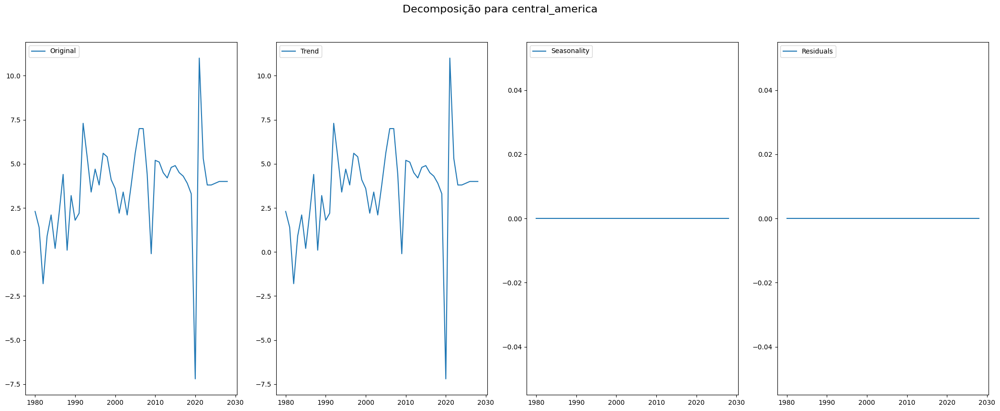

...

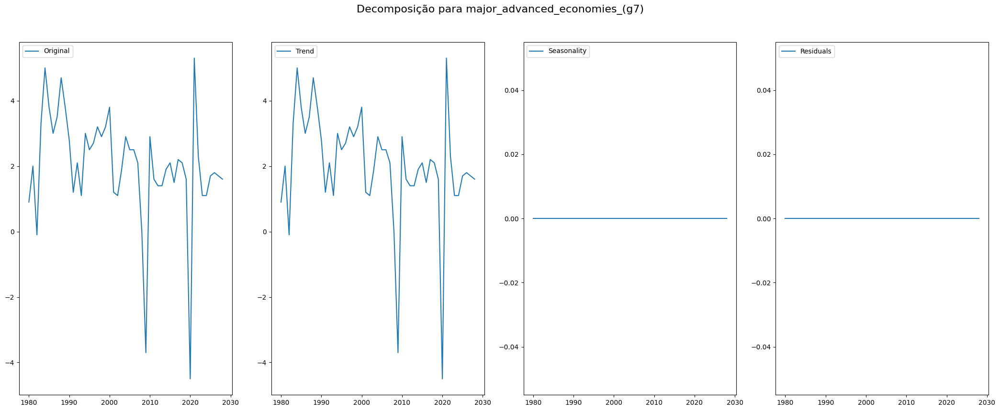

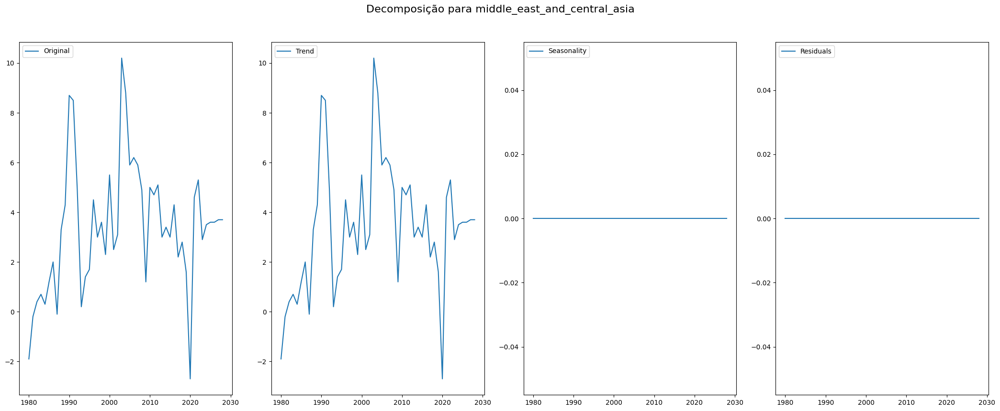

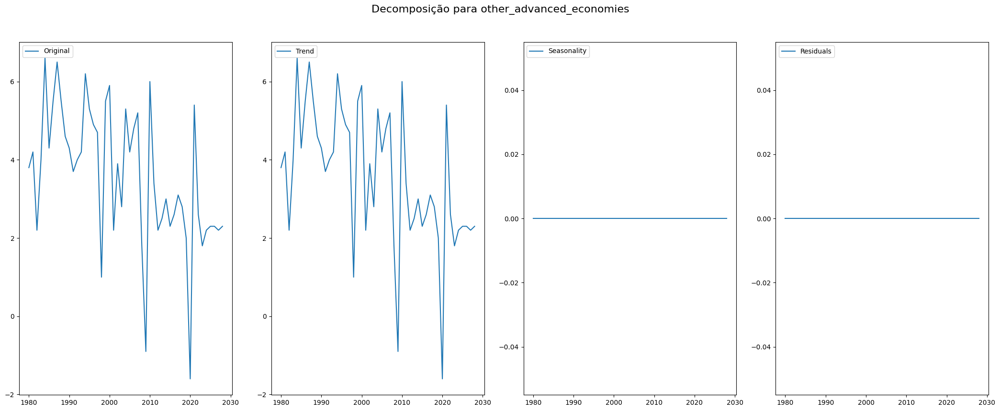

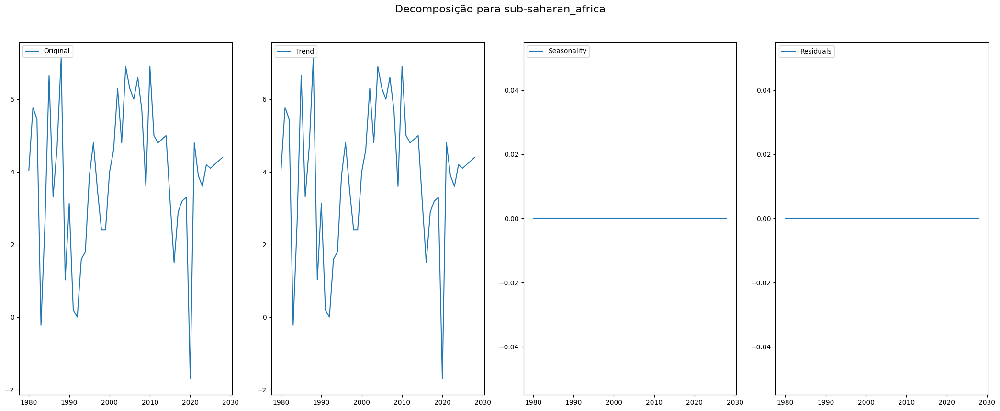

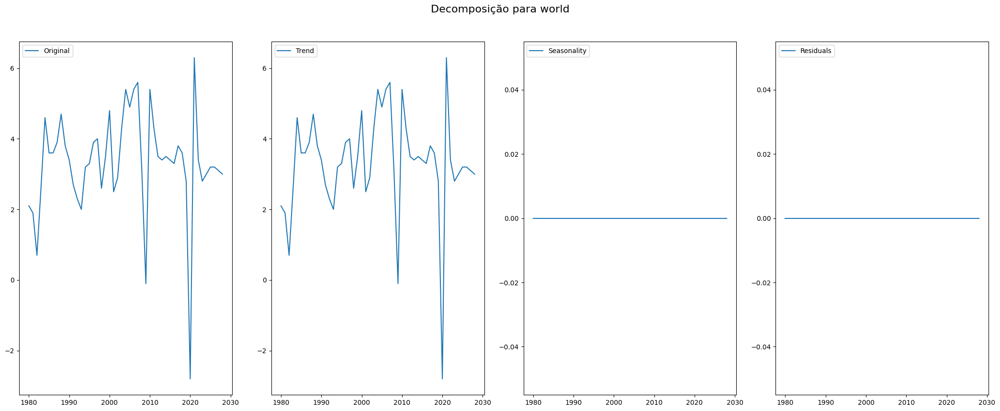

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose


# Loop para realizar a decomposição e gerar os gráficos para cada grupo
for group_name, group_countries_list in groups3.items():
    plt.figure(figsize=(21, 9))
    plt.suptitle(f'Decomposição para {group_name}', fontsize=16)

    for country_series_name in group_countries_list:
        country_series = df_transpose_copy_decompose[country_series_name]  # Seleciona a coluna correspondente à região
        decomposition = seasonal_decompose(country_series, model='additive')
        trend = decomposition.trend
        seasonal = decomposition.seasonal
        residual = decomposition.resid
        
        index = group_countries_list.index(country_series_name)
        
        plt.subplot(len(group_countries_list), 4, index * 4 + 1)
        plt.plot(country_series.index, country_series, label='Original')
        plt.legend(loc='upper left')
        
        plt.subplot(len(group_countries_list), 4, index * 4 + 2)
        plt.plot(country_series.index, trend, label='Trend')
        plt.legend(loc='upper left')
        
        plt.subplot(len(group_countries_list), 4, index * 4 + 3)
        plt.plot(country_series.index, seasonal, label='Seasonality')
        plt.legend(loc='upper left')
        
        plt.subplot(len(group_countries_list), 4, index * 4 + 4)
        plt.plot(country_series.index, residual, label='Residuals')
        plt.legend(loc='upper left')
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Ajusta o espaço para o título
    plt.show()


In [ ]:
#### TESTE (Não deletar, funcionou uma vez e depois não funcionou mais)
#from statsmodels.tsa.seasonal import seasonal_decompose
#
#df_transpose_copy_decompose = df_transposed_copy_inputting_v19.copy()
#
## Loop para realizar a decomposição e gerar os gráficos para cada grupo
#for group_name, group_countries_list in groups3.items():
#    plt.figure(figsize=(21, 21))
#    plt.suptitle(f'Decomposição para {group_name}', fontsize=16)
#
#    country_series = df_transpose_copy_decompose[group_countries_list]  # Seleciona a coluna correspondente à região
#    decomposition = seasonal_decompose(country_series, model='additive')
#    trend = decomposition.trend
#    seasonal = decomposition.seasonal
#    residual = decomposition.resid
#    
#    plt.subplot(len(group_countries_list), 4, group_countries_list.index(group_countries_list) * 4 + 1)
#    plt.plot(country_series.index, country_series, label='Original')
#    plt.legend(loc='upper left')
#    
#    plt.subplot(len(group_countries_list), 4, group_countries_list.index(group_countries_list) * 4 + 2)
#    plt.plot(country_series.index, trend, label='Trend')
#    plt.legend(loc='upper left')
#    
#    plt.subplot(len(group_countries_list), 4, group_countries_list.index(group_countries_list) * 4 + 3)
#    plt.plot(country_series.index, seasonal, label='Seasonality')
#    plt.legend(loc='upper left')
#    
#    plt.subplot(len(group_countries_list), 4, group_countries_list.index(group_countries_list) * 4 + 4)
#    plt.plot(country_series.index, residual, label='Residuals')
#    plt.legend(loc='upper left')
#    
#    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Ajusta o espaço para o título
#    plt.show()
#
#

Iremos realizar a decomposição para um país para analisarmos se os gráficos resultantes de Trend permanecem o mesmo que o Original.

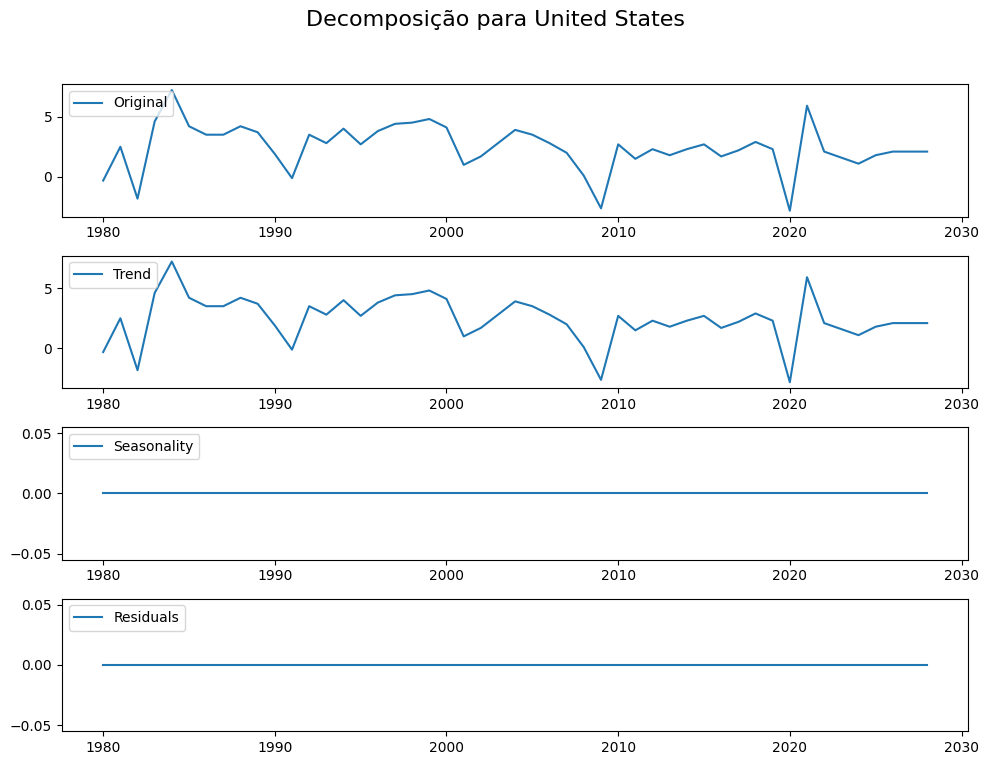

In [ ]:

country_name = "United States"  # Substitua pelo nome do país desejado

plt.figure(figsize=(10, 8))
plt.suptitle(f'Decomposição para {country_name}', fontsize=16)

country_series = df_transpose_copy_decompose[country_name]  # Seleciona a coluna correspondente ao país

decomposition = seasonal_decompose(country_series, model='additive')
trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

plt.subplot(4, 1, 1)
plt.plot(country_series.index, country_series, label='Original')
plt.legend(loc='upper left')

plt.subplot(4, 1, 2)
plt.plot(country_series.index, trend, label='Trend')
plt.legend(loc='upper left')

plt.subplot(4, 1, 3)
plt.plot(country_series.index, seasonal, label='Seasonality')
plt.legend(loc='upper left')

plt.subplot(4, 1, 4)
plt.plot(country_series.index, residual, label='Residuals')
plt.legend(loc='upper left')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Ajusta o espaço para o título
plt.show()


Considerando que a decomposição não retornou os resultados esperados (gráfico de trend como uma linha reta no eixo X) é possível que tenha ocorrido um ajuste estatístico nos dados originais.

Podemos também aplicar o método das diferenças. Valores negativos indicam que houve uma queda em relação ao valor anterior. 

In [ ]:
df_transpose_copy_diff = df_transposed_copy_inputting_v19.copy()
#df_transpose_copy_diff.to_csv('Projeto/Data/Output/df_transpose_diff.xlsx')

In [ ]:

for group_name, group_countries_list in groups3.items():
    # Seleciona apenas as colunas correspondentes aos países do grupo
    group_data = df_transpose_copy_diff[group_countries_list]
    
    # Calcula a diferença entre as observações dos países do grupo
    diff_data = group_data.diff()
    
    # Imprime a tabela resultante das diferenças
    print(f"Diferenças para o grupo {group_name}:\n{diff_data}")

Diferenças para o grupo africa:
Real GDP growth (Annual percent change)  Africa (Region)
year                                                    
1980-01-01                                           NaN
1981-01-01                                     -2.803094
1982-01-01                                      4.180449
1983-01-01                                      0.382146
1984-01-01                                     -0.723027
1985-01-01                                     -1.894370
1986-01-01                                     -0.209139
1987-01-01                                      0.057562
1988-01-01                                     -0.415274
1989-01-01                                      3.791627
1990-01-01                                     -6.604852
1991-01-01                                      1.936232
1992-01-01                                     -2.200000
1993-01-01                                      0.800000
1994-01-01                                      1.600000

<Figure size 1500x600 with 0 Axes>

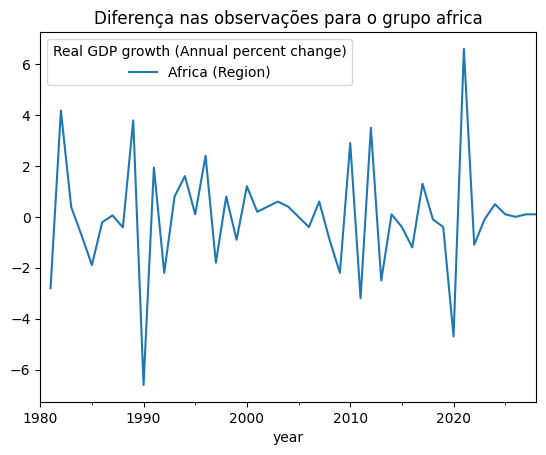

<Figure size 1500x600 with 0 Axes>

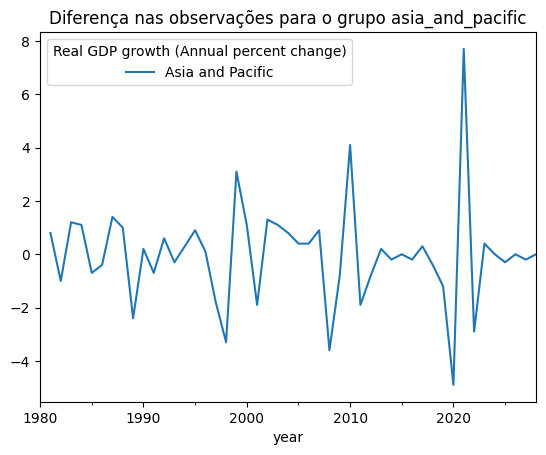

<Figure size 1500x600 with 0 Axes>

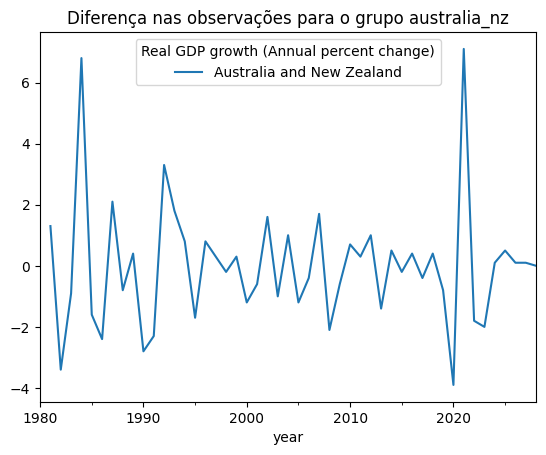

<Figure size 1500x600 with 0 Axes>

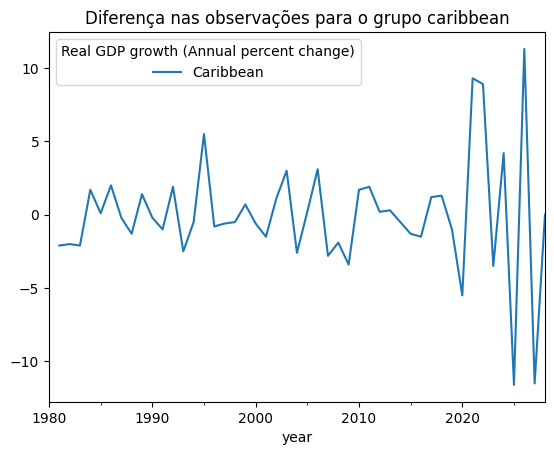

<Figure size 1500x600 with 0 Axes>

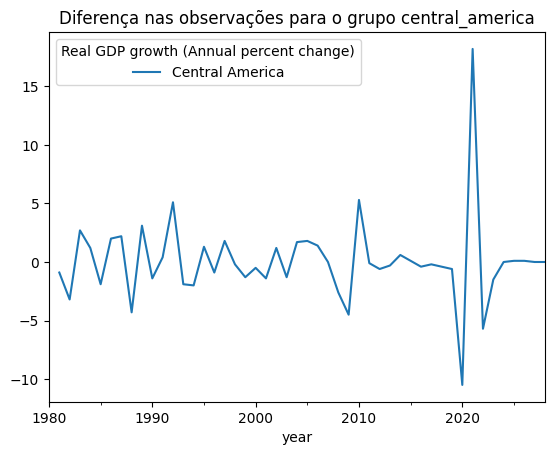

<Figure size 1500x600 with 0 Axes>

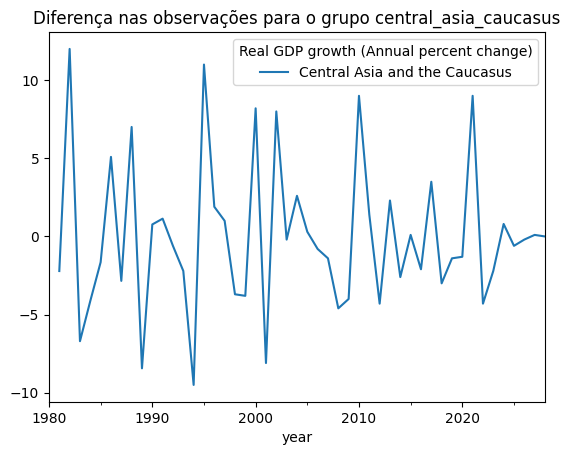

<Figure size 1500x600 with 0 Axes>

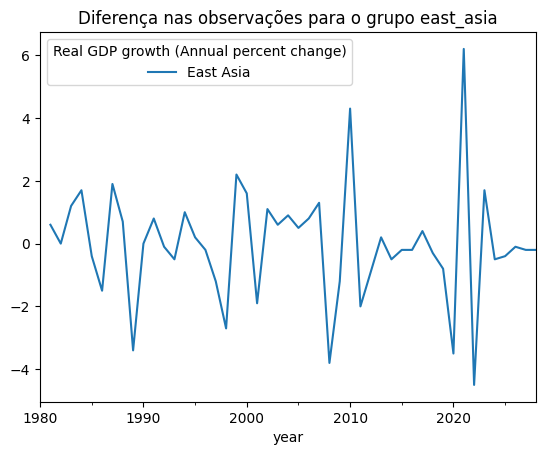

<Figure size 1500x600 with 0 Axes>

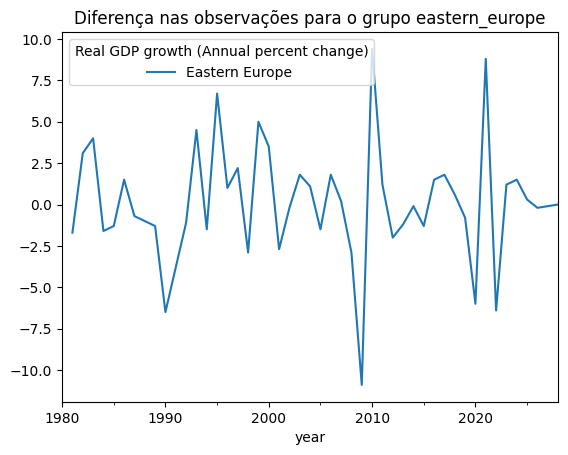

<Figure size 1500x600 with 0 Axes>

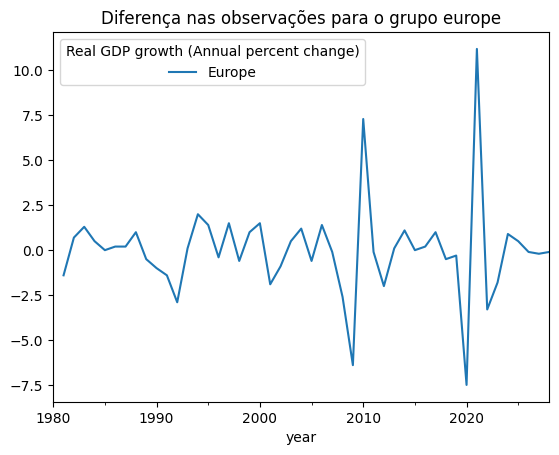

<Figure size 1500x600 with 0 Axes>

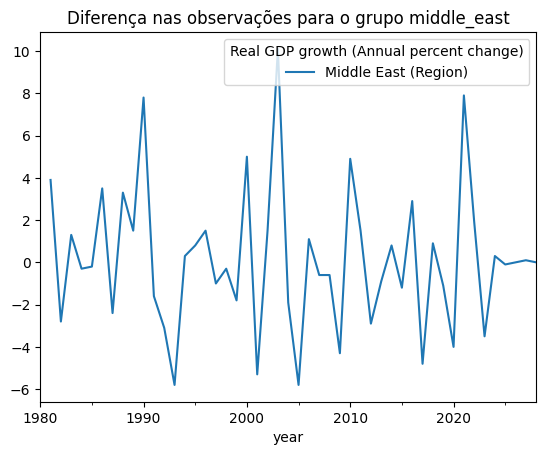

<Figure size 1500x600 with 0 Axes>

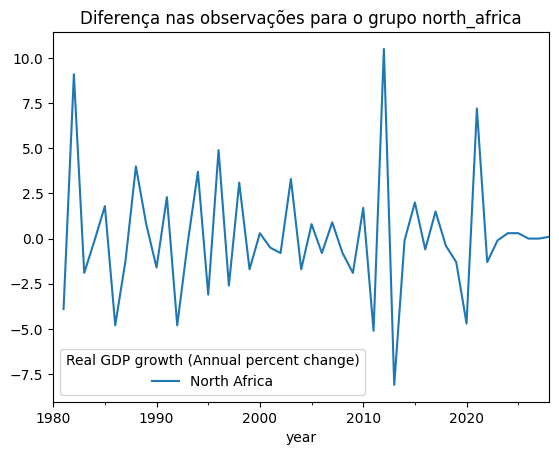

<Figure size 1500x600 with 0 Axes>

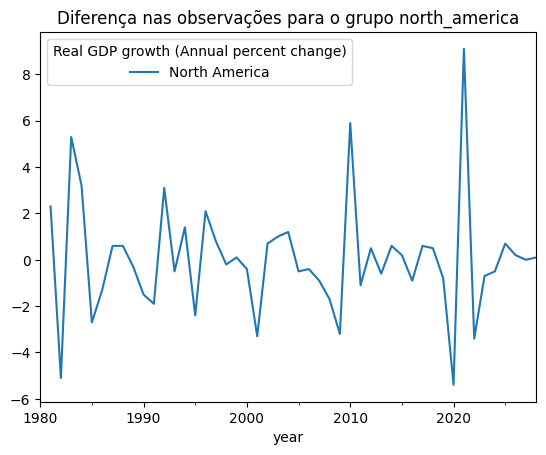

<Figure size 1500x600 with 0 Axes>

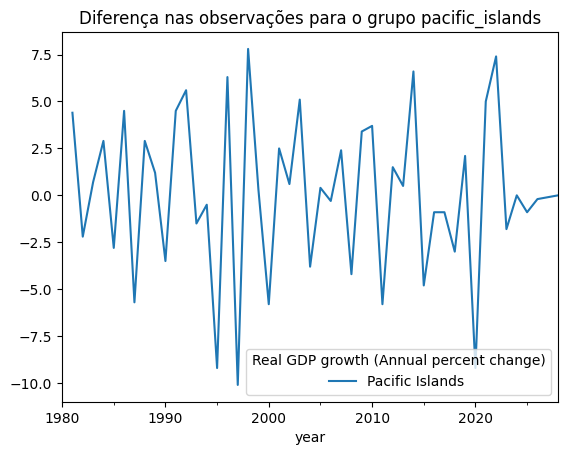

<Figure size 1500x600 with 0 Axes>

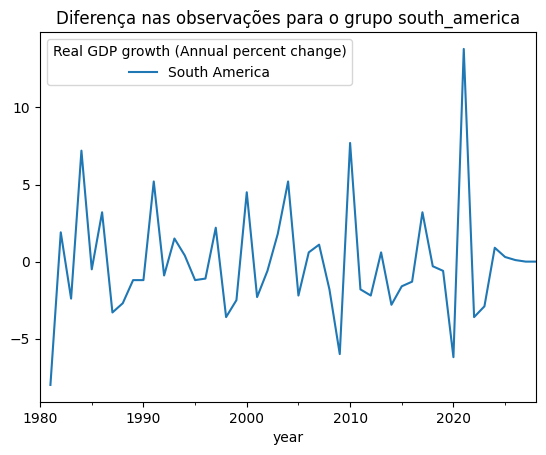

<Figure size 1500x600 with 0 Axes>

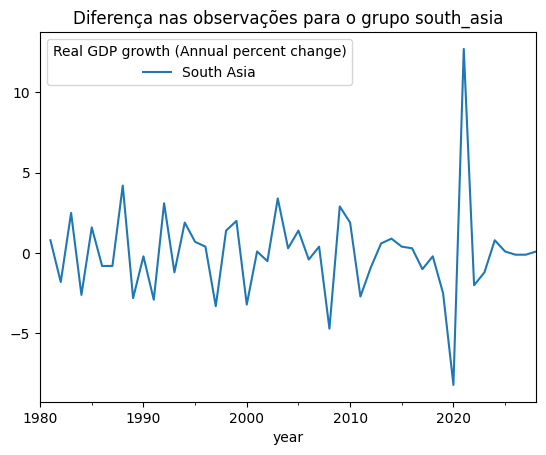

<Figure size 1500x600 with 0 Axes>

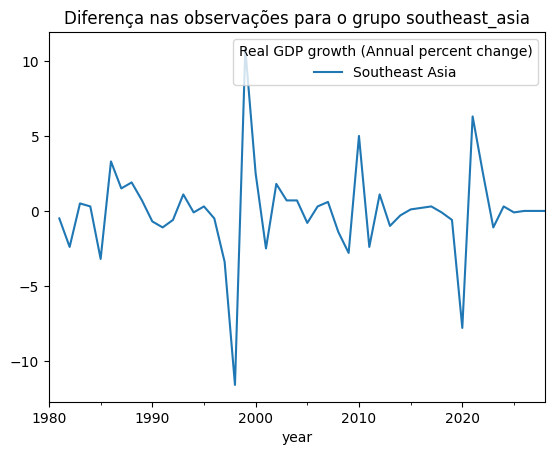

<Figure size 1500x600 with 0 Axes>

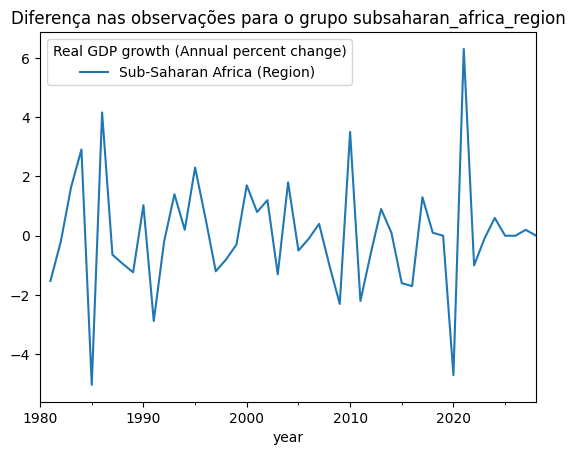

<Figure size 1500x600 with 0 Axes>

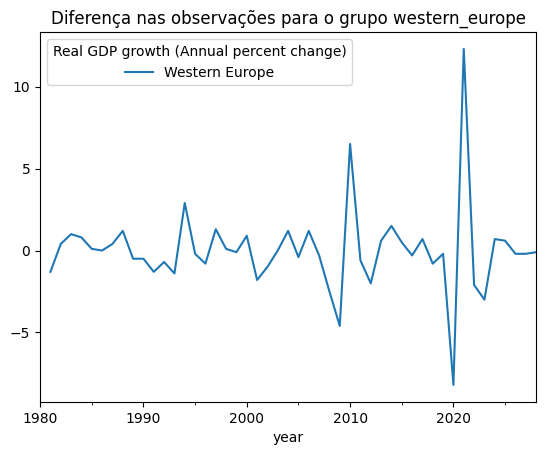

<Figure size 1500x600 with 0 Axes>

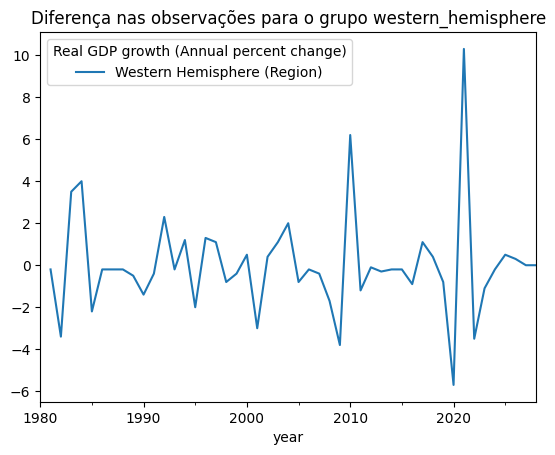

<Figure size 1500x600 with 0 Axes>

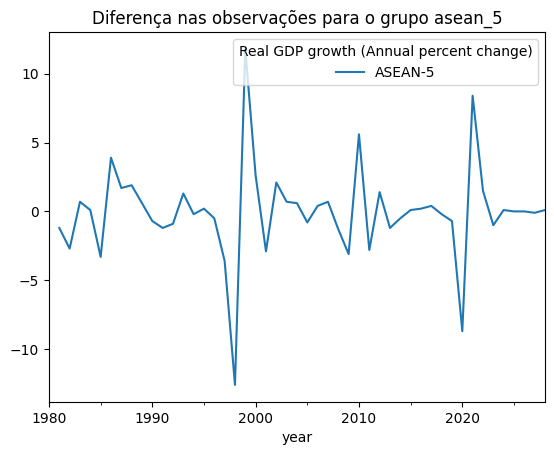

<Figure size 1500x600 with 0 Axes>

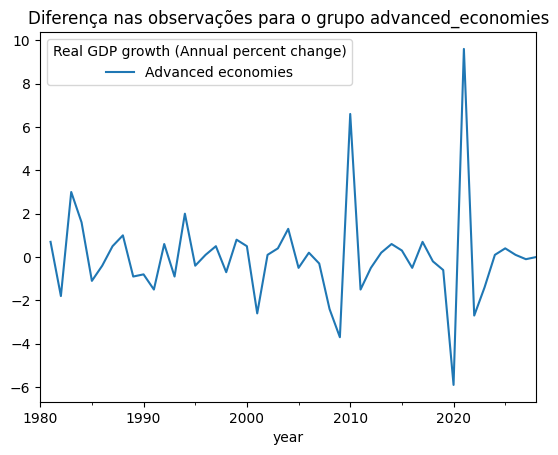

<Figure size 1500x600 with 0 Axes>

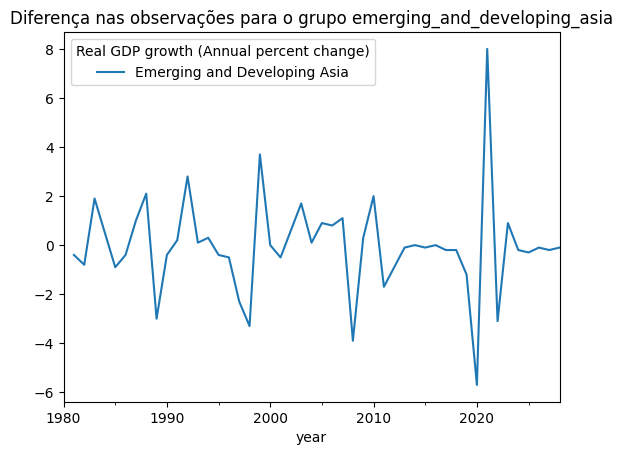

<Figure size 1500x600 with 0 Axes>

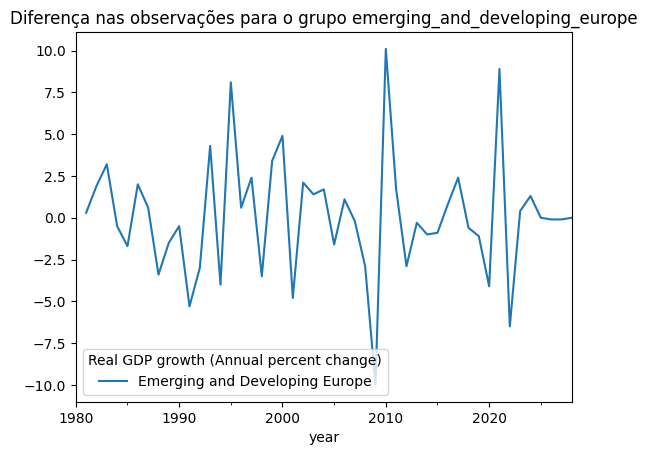

<Figure size 1500x600 with 0 Axes>

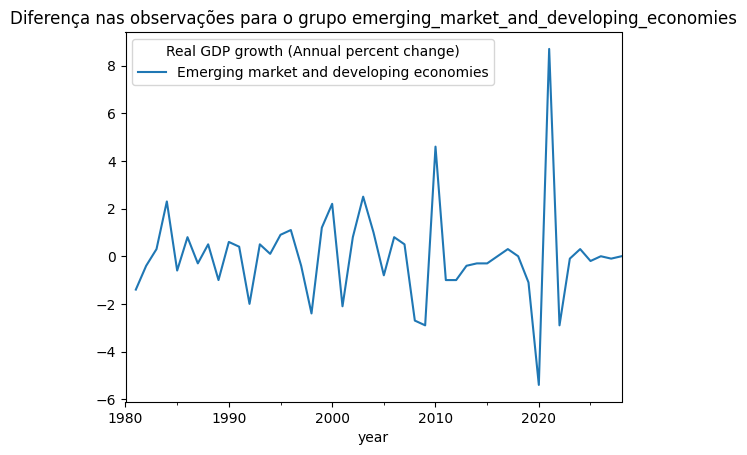

<Figure size 1500x600 with 0 Axes>

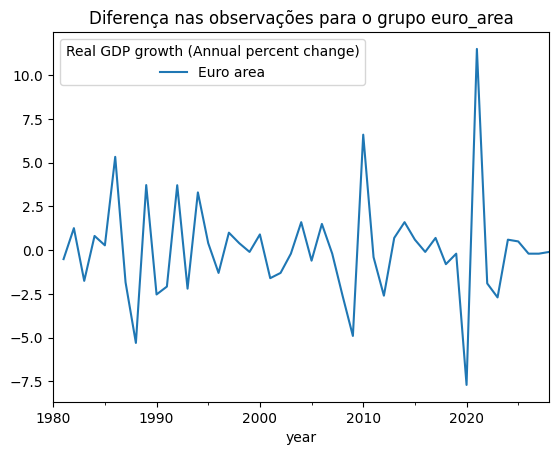

<Figure size 1500x600 with 0 Axes>

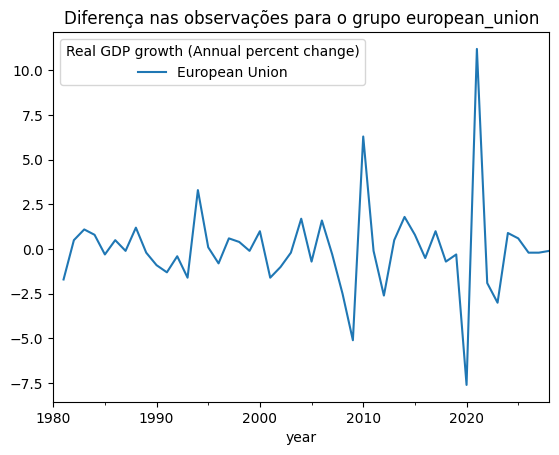

<Figure size 1500x600 with 0 Axes>

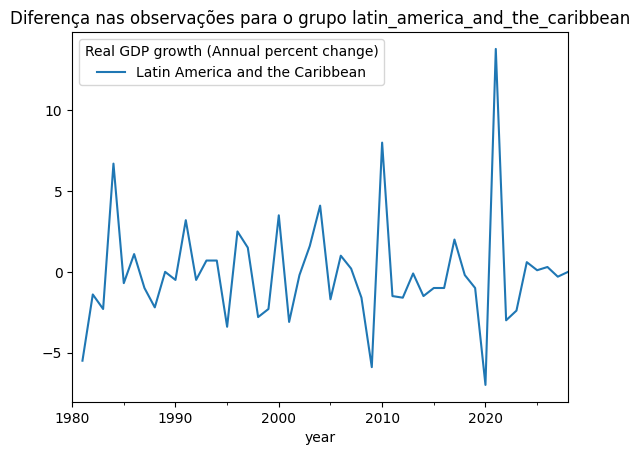

<Figure size 1500x600 with 0 Axes>

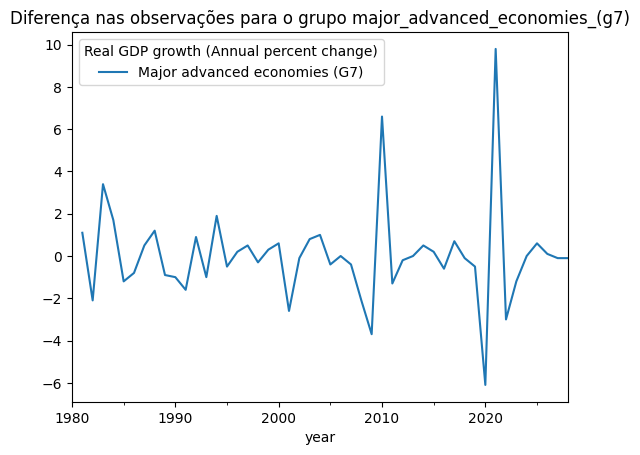

<Figure size 1500x600 with 0 Axes>

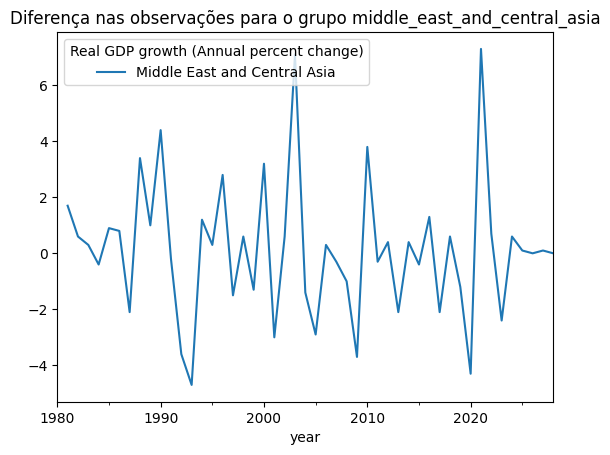

<Figure size 1500x600 with 0 Axes>

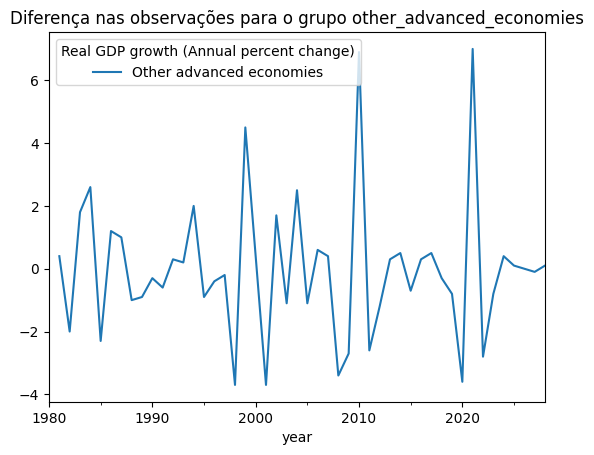

<Figure size 1500x600 with 0 Axes>

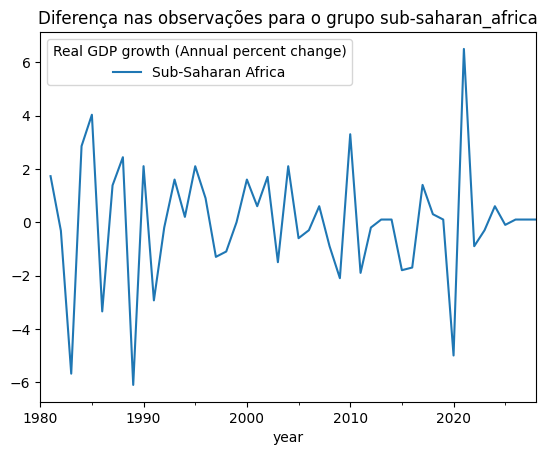

<Figure size 1500x600 with 0 Axes>

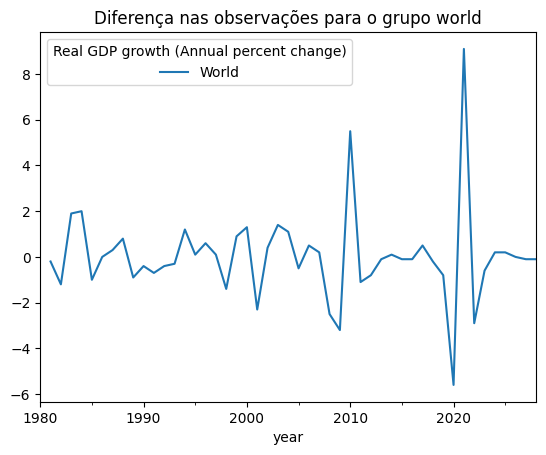

Grupos com maiores variações nas diferenças:
middle_east: 6.499999999999998
middle_east_and_central_asia: 5.600000000000001
pacific_islands: 5.100000000000001
north_africa: 4.399999999999998
emerging_and_developing_europe: 3.100000000000003
eastern_europe: 3.0
central_america: 1.6999999999999993
north_america: 1.100000000000001
euro_area: 1.0996879656685716
subsaharan_africa_region: 1.074688458836464
world: 0.8999999999999999
south_asia: 0.8000000000000003
major_advanced_economies_(g7): 0.7000000000000026
emerging_market_and_developing_economies: 0.6000000000000019
advanced_economies: 0.5000000000000009
sub-saharan_africa: 0.3530634161453756
europe: 0.1999999999999995
western_hemisphere: 1.7763568394002505e-15
european_union: -0.0999999999999992
africa: -0.10174141550336024
western_europe: -0.20000000000000018
australia_nz: -0.2999999999999954
asia_and_pacific: -0.5000000000000009
east_asia: -1.3000000000000012
other_advanced_economies: -1.5000000000000009
central_asia_caucasus: -1.673

In [ ]:

# Dicionário para armazenar as variações de cada grupo
group_variations = {}

for group_name, group_countries_list in groups3.items():
    # Seleciona apenas as colunas correspondentes aos países do grupo
    group_data = df_transpose_copy_diff[group_countries_list]
    
    # Calcula a diferença entre as observações dos países do grupo
    diff_data = group_data.diff()
    
    # Calcula a variação total das diferenças para o grupo
    total_variation = diff_data.sum().sum()
    
    # Armazena a variação no dicionário
    group_variations[group_name] = total_variation
    
    # Plota a série temporal das diferenças
    plt.figure(figsize=(15, 6))
    diff_data.plot(title=f"Diferença nas observações para o grupo {group_name}")
    plt.show()

# Classifica os grupos com base nas variações
sorted_groups = sorted(group_variations.items(), key=lambda x: x[1], reverse=True)

# Imprime os grupos classificados com base nas maiores variações
print("Grupos com maiores variações nas diferenças:")
for group_name, variation in sorted_groups:
    print(f"{group_name}: {variation}")


### Evolução da variação das diferenças vs média

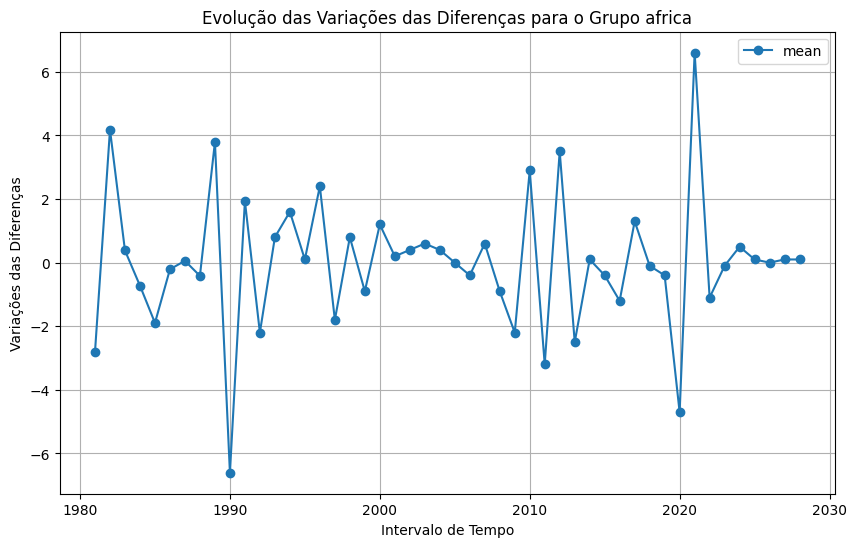

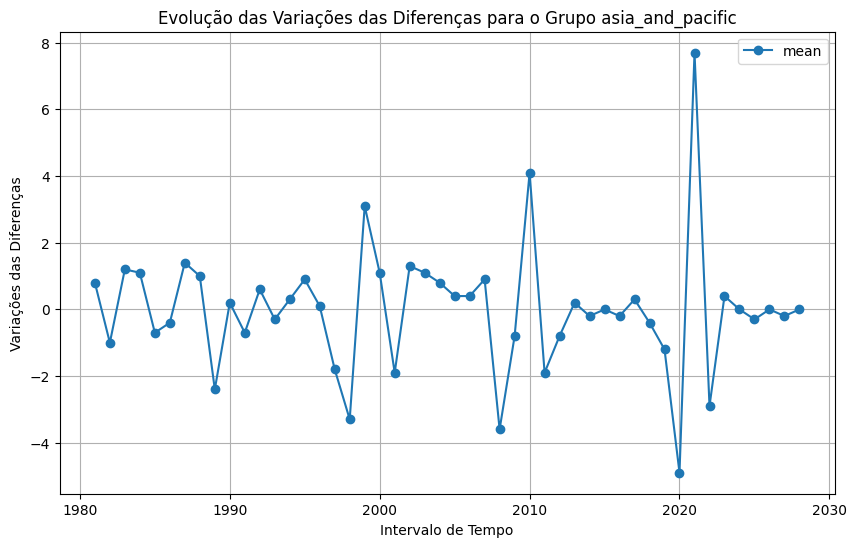

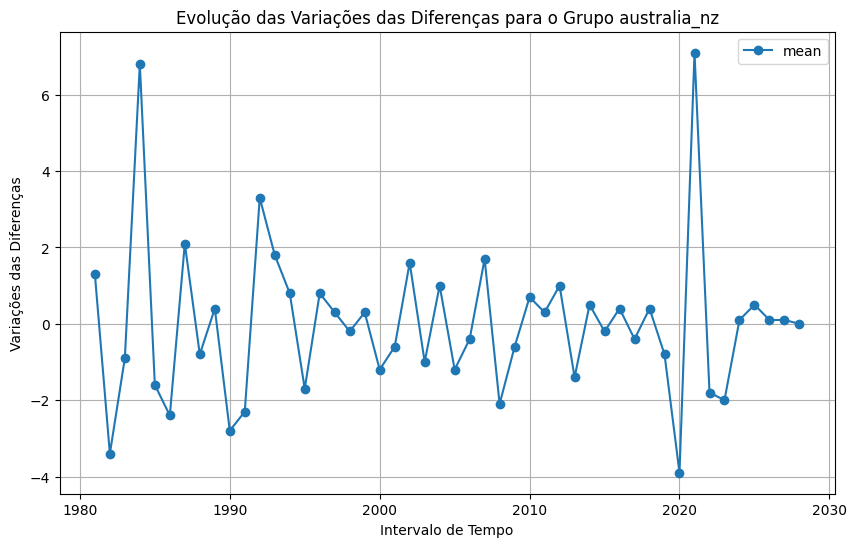

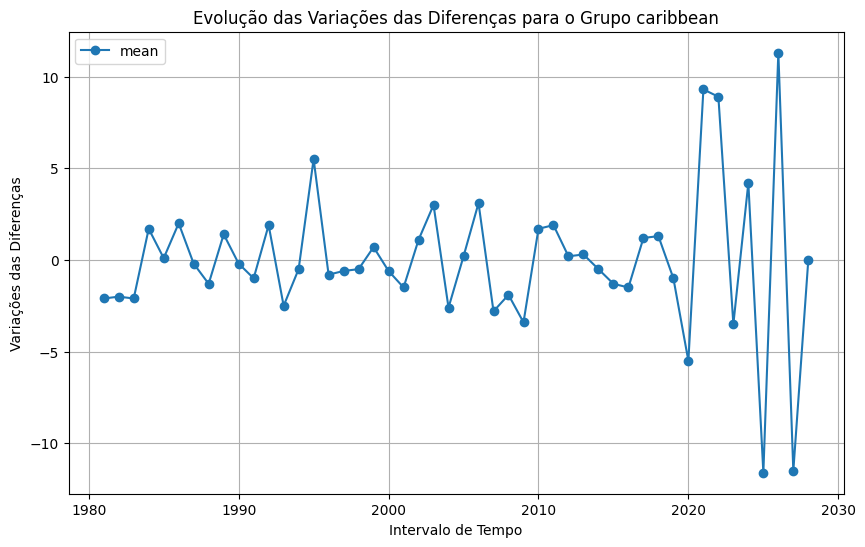

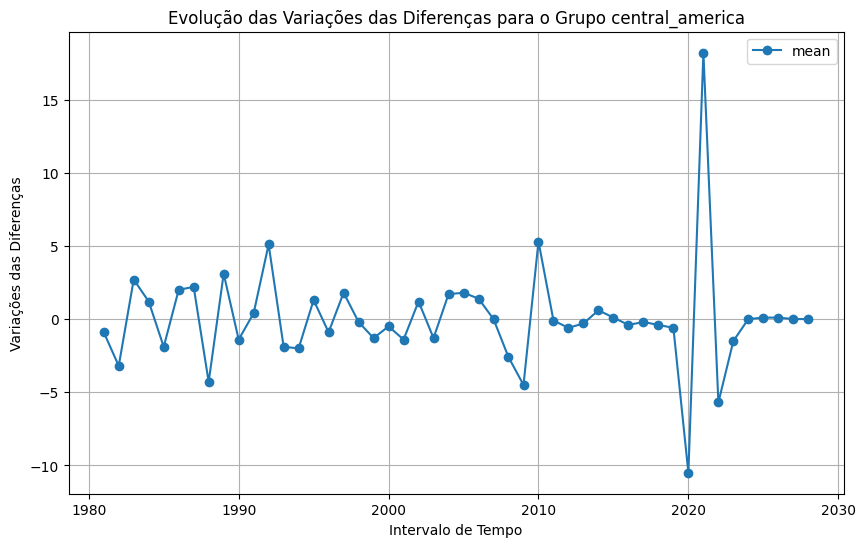

...

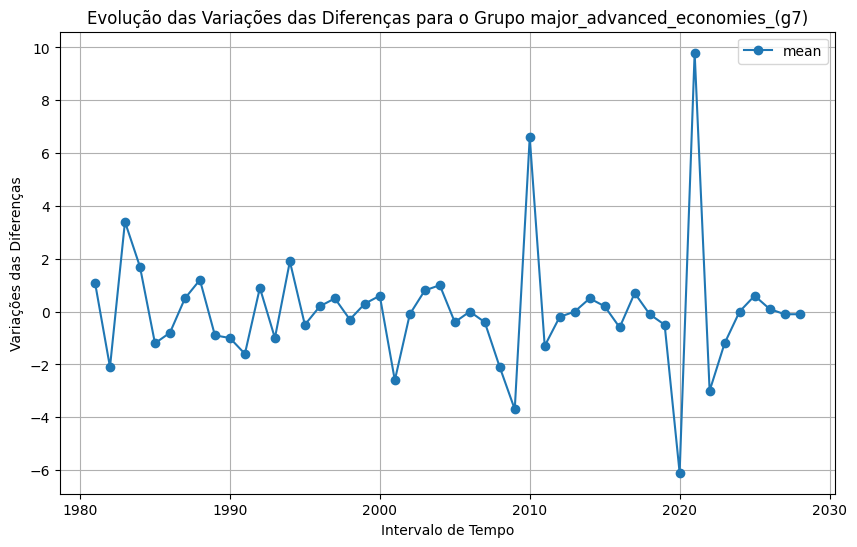

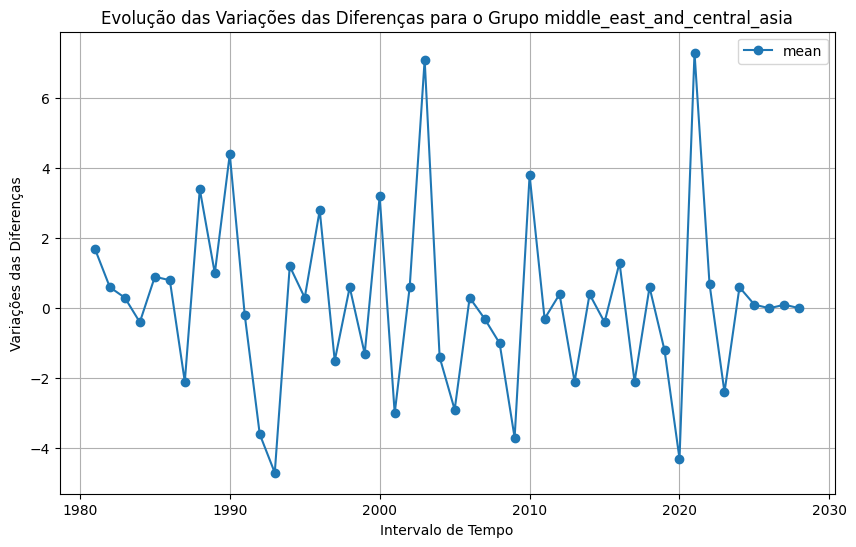

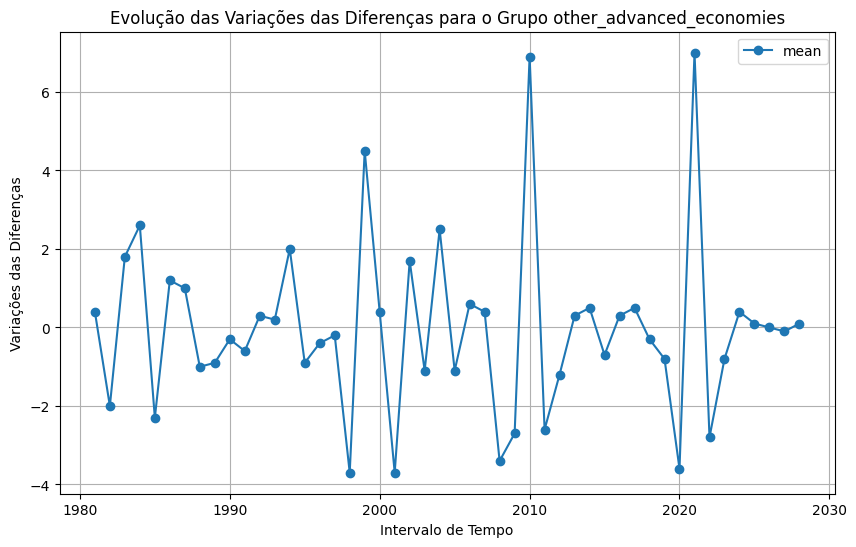

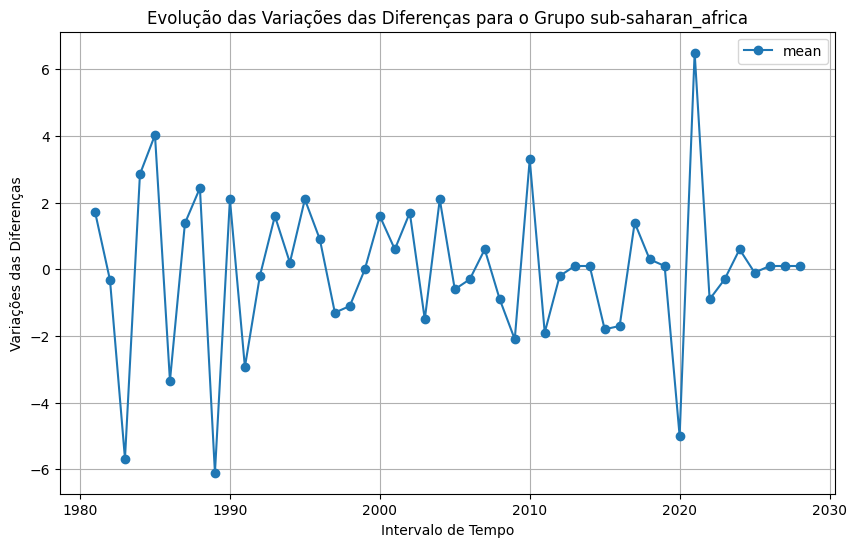

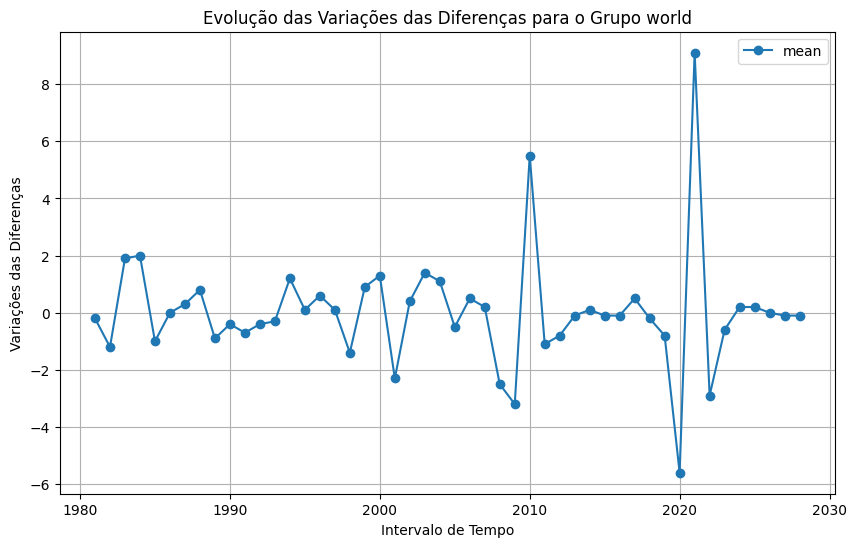

In [ ]:
import matplotlib.pyplot as plt

# Dicionário para armazenar as médias e variações de cada grupo
group_data_info = {}

for group_name, group_countries_list in groups3.items():
    # Seleciona apenas as colunas correspondentes aos países do grupo
    group_data = df_transpose_copy_diff[group_countries_list]
    
    # Calcula a diferença entre as observações dos países do grupo
    diff_data = group_data.diff()
    
    # Calcula a variação total das diferenças para o grupo
    total_variation = diff_data.sum().sum()
    
    # Calcula a média das observações dos países do grupo
    group_mean = group_data.mean().mean()
    
    # Armazena a variação e média no dicionário
    group_data_info[group_name] = {'mean': group_mean, 'variation': total_variation, 'diff_data': diff_data}

# Criar um gráfico separado para cada grupo
for group_name, data in group_data_info.items():
    plt.figure(figsize=(10, 6))
    plt.plot(data['diff_data'], marker='o')
    plt.xlabel('Intervalo de Tempo')
    plt.ylabel('Variações das Diferenças')
    plt.title(f'Evolução das Variações das Diferenças para o Grupo {group_name}')
    plt.legend(data.keys())
    plt.grid(True)
    plt.show()


### Matriz de Correlação e Gráficos de Correlação

In [ ]:
# Loop sobre os grupos de países
for group_name, country_list in groups3.items():
    # Selecione os países do grupo
    df_group = df_transpose_copy_diff.loc[:, country_list]
    
    # Exiba a matriz de correlação como uma tabela
    print(f"Correlation Table for Group: {group_name}")
    print(df_group.corr())

Correlation Table for Group: advanced_economies
Real GDP growth (Annual percent change)   Andorra     Aruba  Australia  \
Real GDP growth (Annual percent change)                                  
Andorra                                  1.000000  0.545828   0.426422   
Aruba                                    0.545828  1.000000   0.483278   
Australia                                0.426422  0.483278   1.000000   
Austria                                  0.698650  0.597535   0.346852   
Bahrain                                  0.275301  0.152666   0.113548   
Belgium                                  0.704617  0.646131   0.560929   
Canada                                   0.522802  0.589922   0.791552   
Cyprus                                   0.575744  0.433374   0.364494   
Czech Republic                           0.579895  0.396526   0.333618   
Denmark                                  0.518510  0.305230   0.288862   
Estonia                                  0.464352  0.226531   0.

/tmp/ipykernel_238129/3333917859.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  f = plt.figure(figsize=(19, 15))


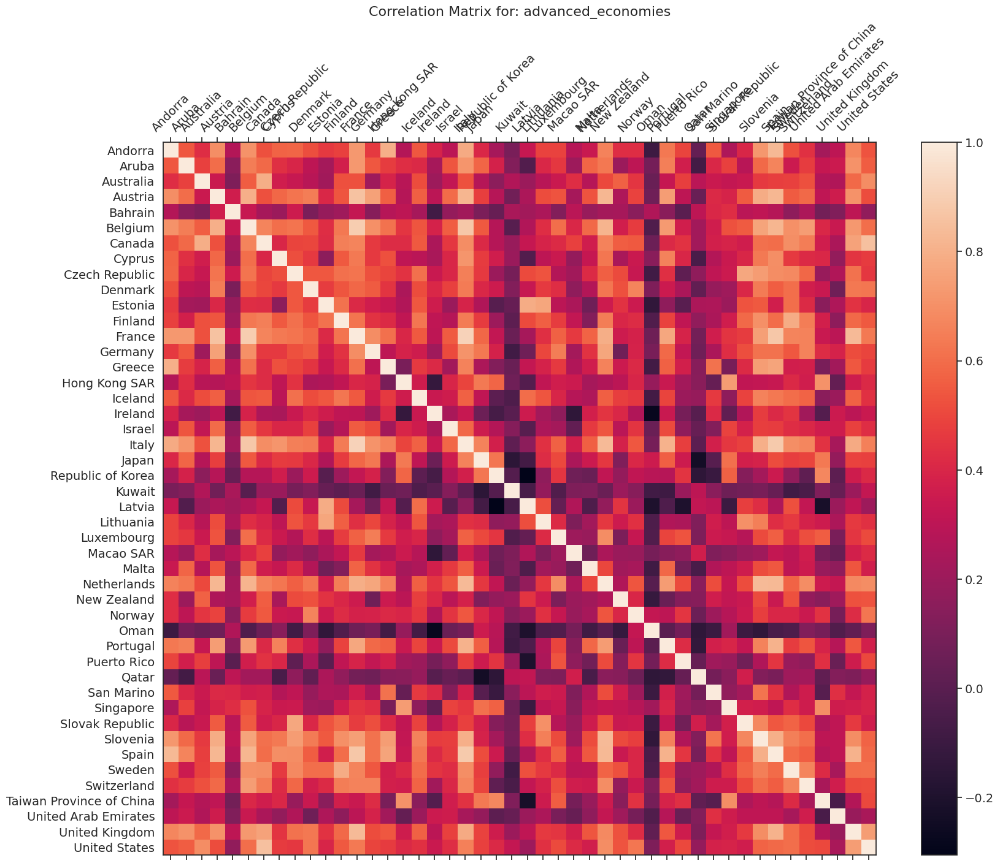

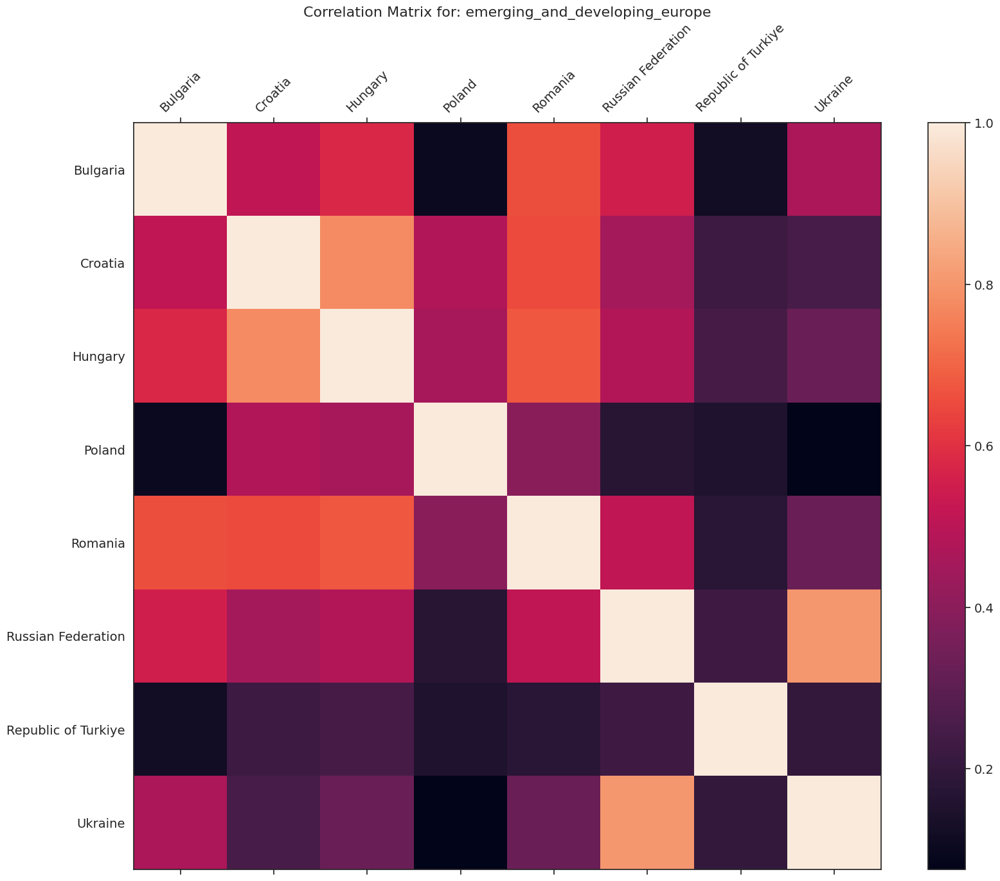

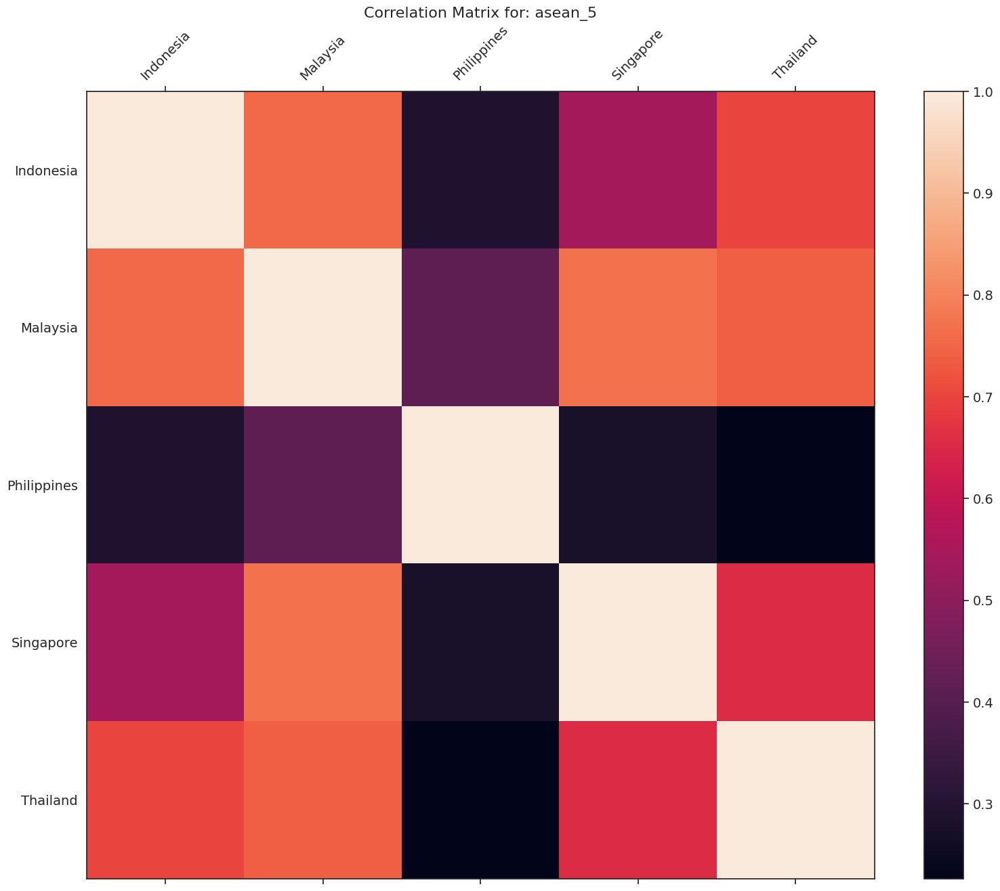

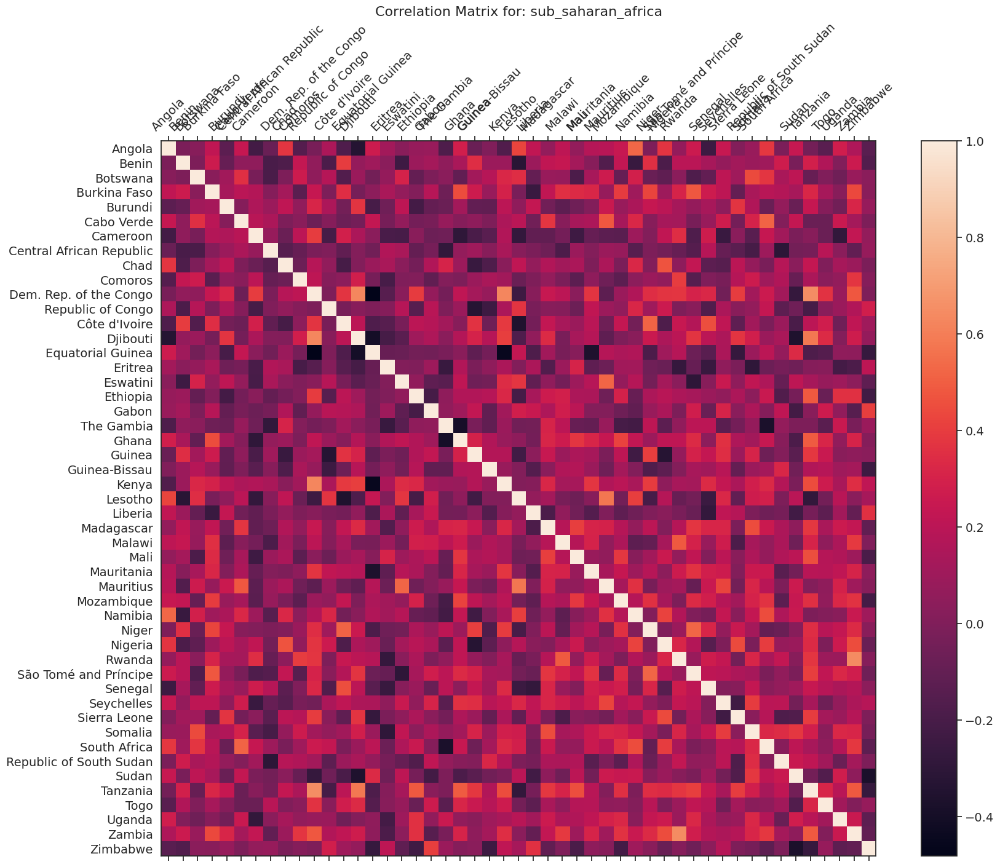

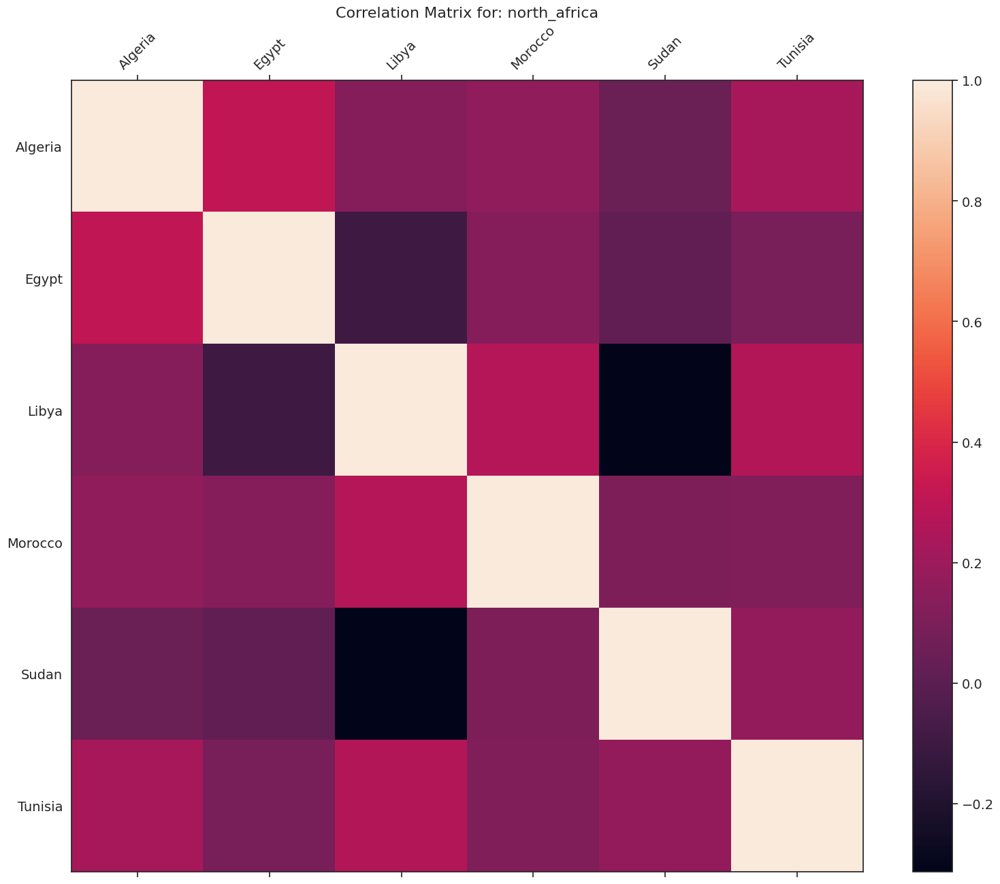

...

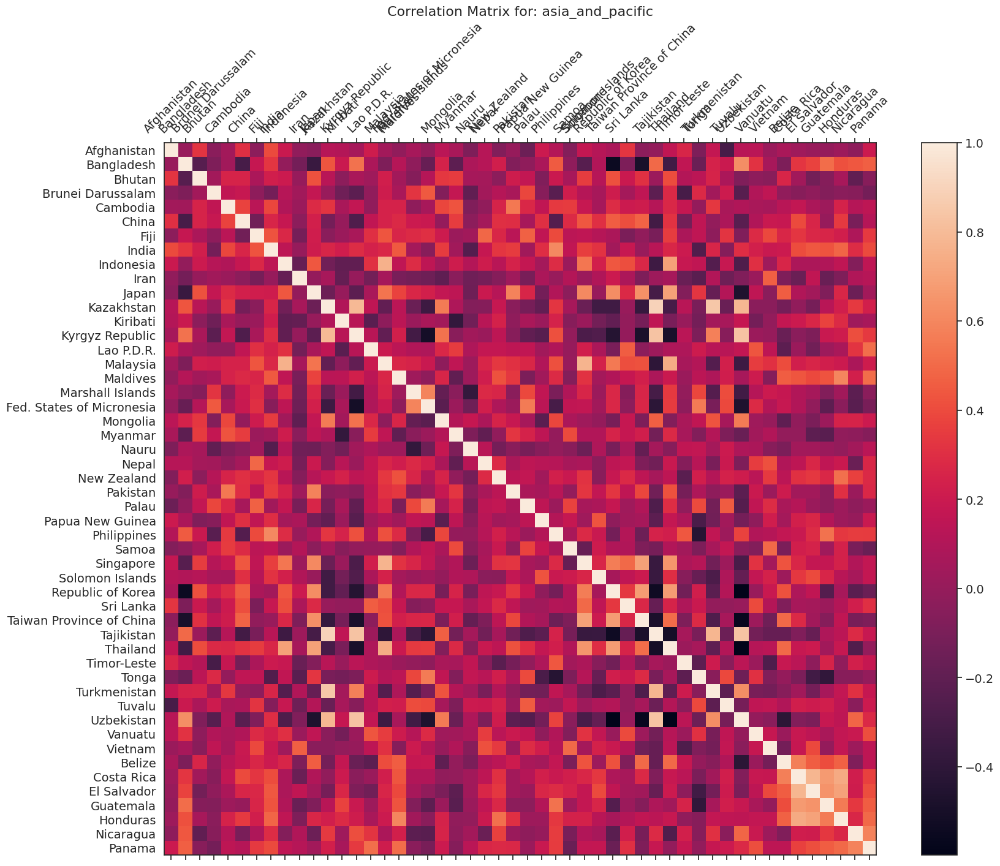

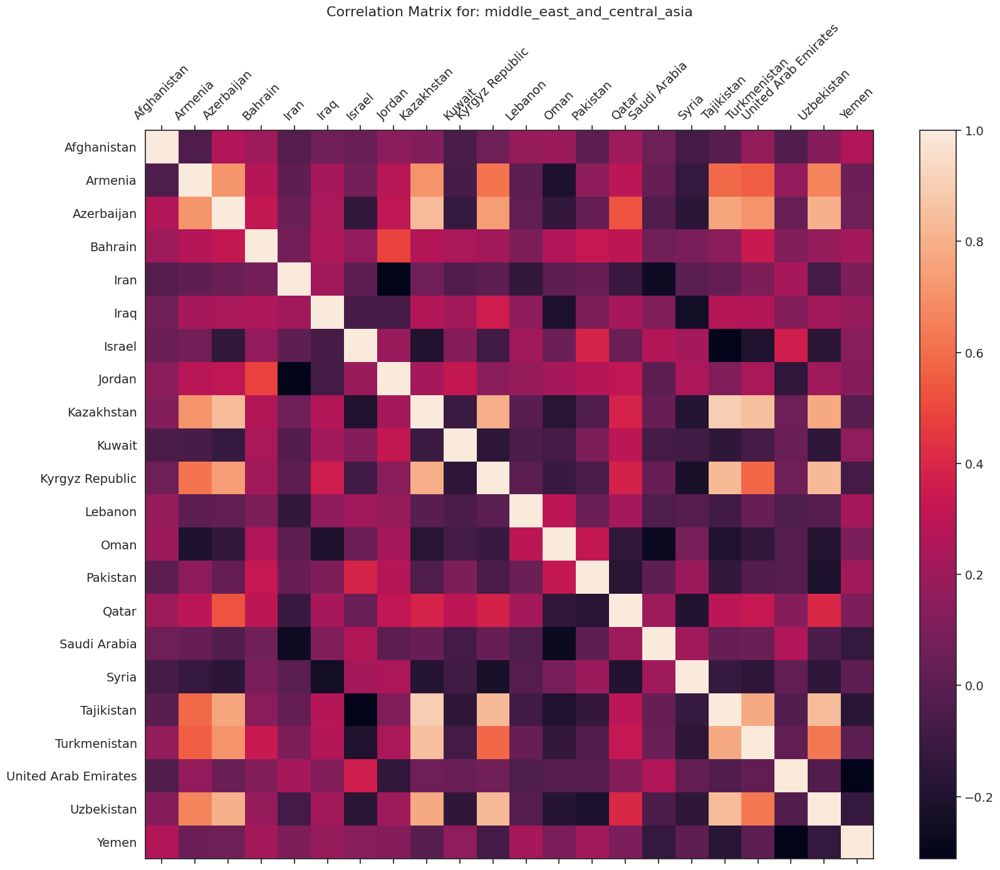

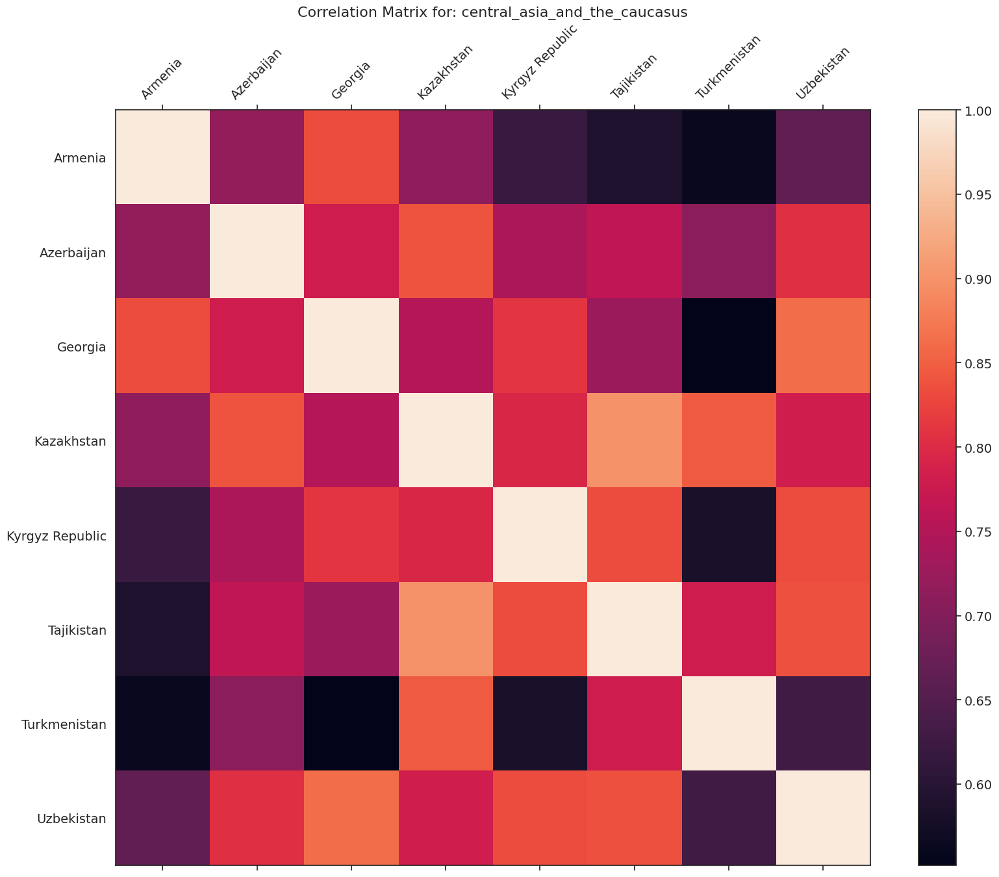

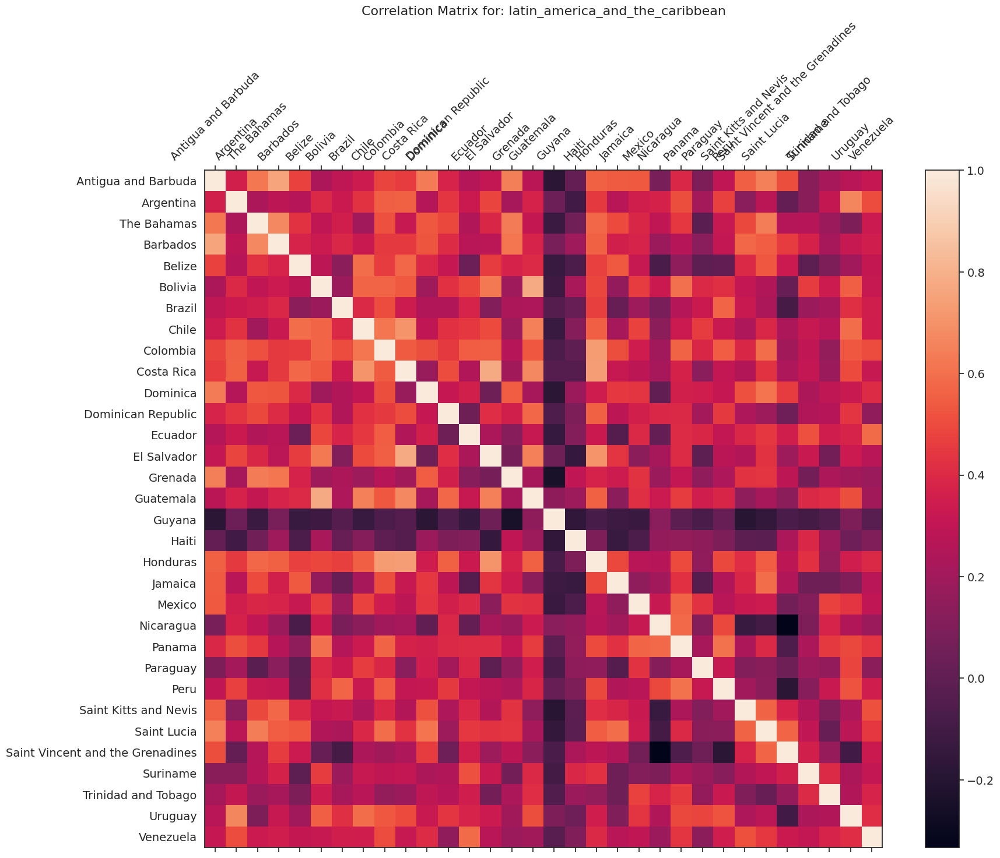

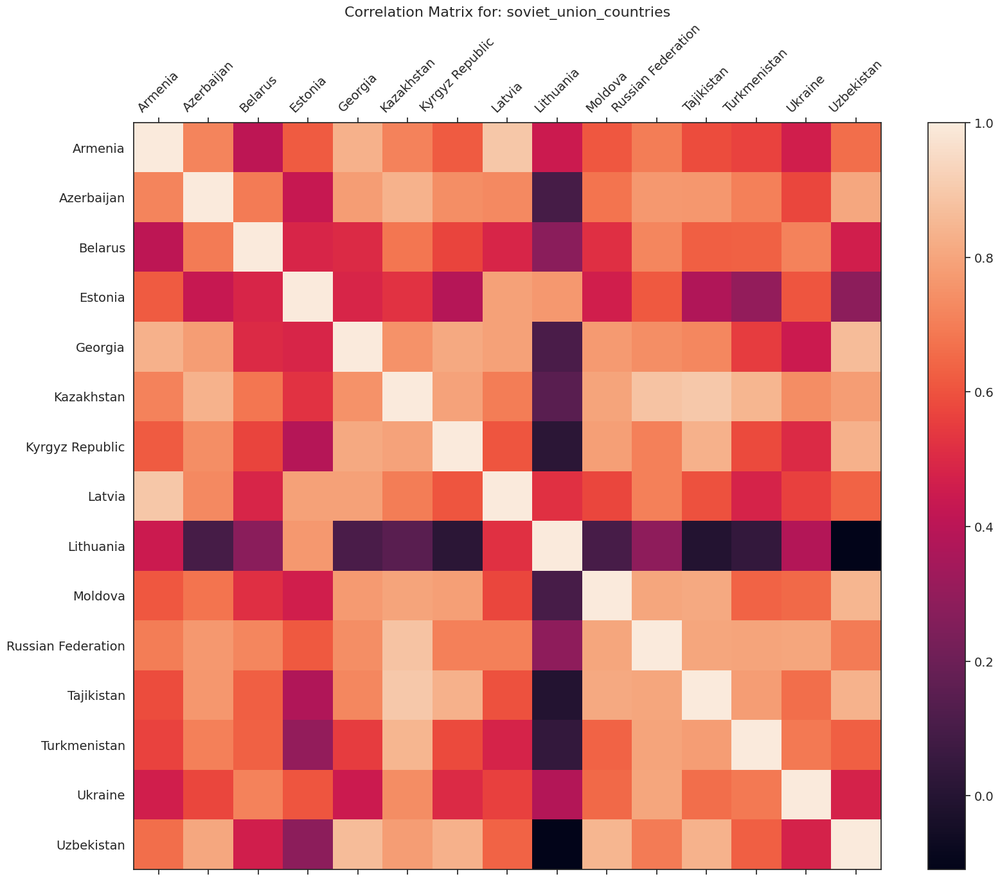

In [ ]:
for group_name, country_list in groups3.items():
    # Selecione os países do grupo
    df_group = df_transpose_copy_diff.loc[:, country_list]
    f = plt.figure(figsize=(19, 15))
    plt.matshow(df_group.corr(), fignum=f.number)
    plt.xticks(range(df_group.select_dtypes(['number']).shape[1]), df_group.select_dtypes(['number']).columns, fontsize=14, rotation=45)
    plt.yticks(range(df_group.select_dtypes(['number']).shape[1]), df_group.select_dtypes(['number']).columns, fontsize=14)
    cb = plt.colorbar()
    cb.ax.tick_params(labelsize=14)
    plt.title(f'Correlation Matrix for: {group_name}', fontsize=16)


### Plot de ACF para os países

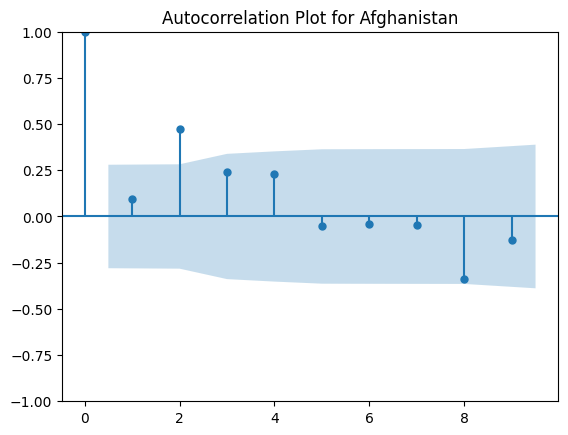

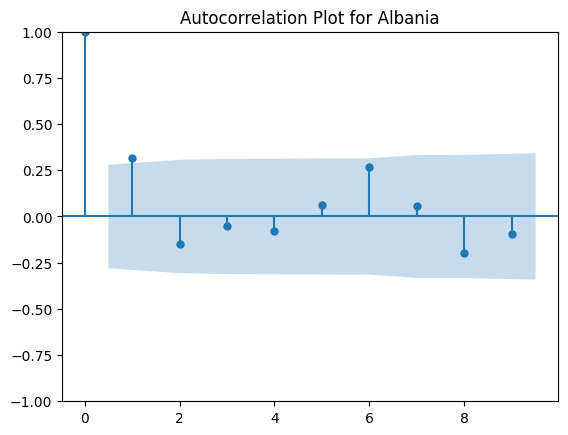

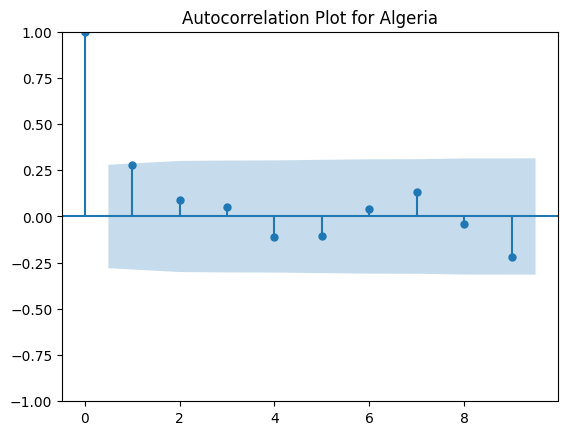

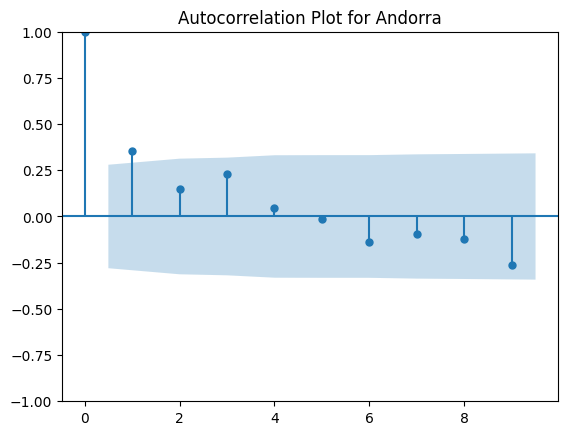

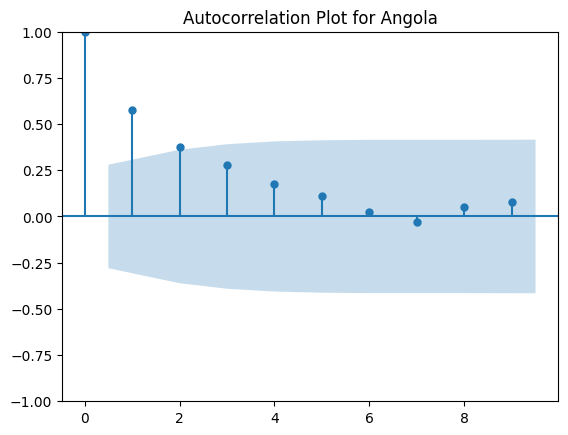

...

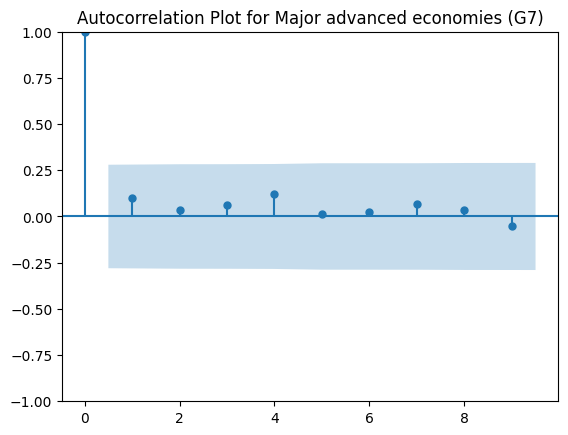

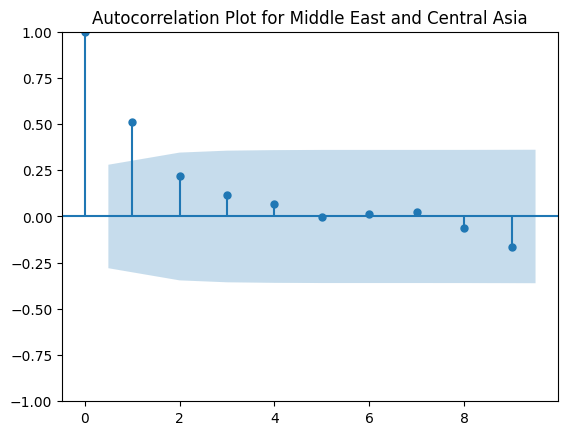

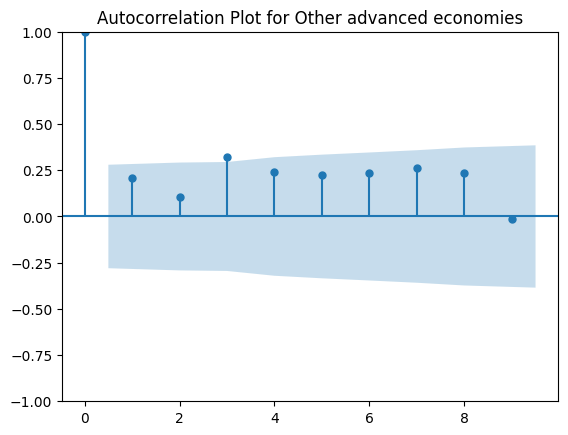

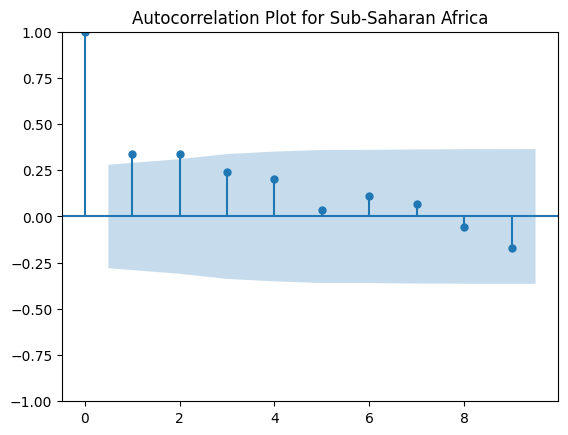

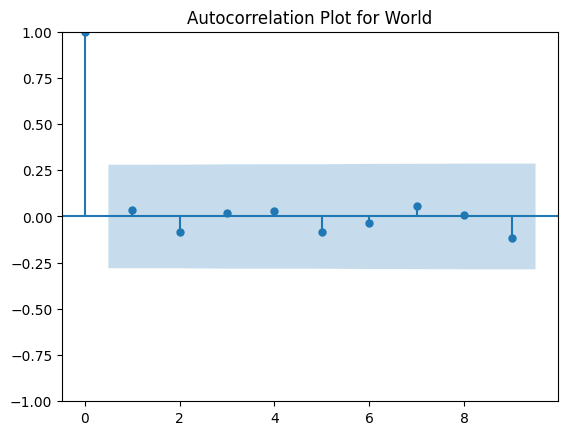

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf
for country in df_transpose_copy_diff.columns:
    plot_acf(df_transpose_copy_diff[country], lags=9)
    plt.title(f'Autocorrelation Plot for {country}')
    plt.show()


### Teste ADF para os países

In [ ]:
from statsmodels.tsa.stattools import adfuller
import warnings
from statsmodels.tools.sm_exceptions import InterpolationWarning
# Listas para armazenar os resultados
series_estacionarias = []
series_nao_estacionarias = []

# Loop através de todas as colunas do DataFrame
for country_column in df_transpose_copy_diff.columns:
    # Selecionar a série temporal do país atual
    series_to_test = df_transpose_copy_diff[country_column]

    # Calcular o teste ADF
    result = adfuller(series_to_test)
    adf_statistic = result[0]
    p_value = result[1]
    critical_values = result[4]

    # Definir o nível de significância
    significance_level = 0.05

    # Verificar se a série é estacionária com o teste ADF
    if p_value <= significance_level:
        series_estacionarias.append(country_column)
        print(f"A série para {country_column} é estacionária.")
    else:
        series_nao_estacionarias.append(country_column)
        print(f"A série para {country_column} é não estacionária.")

    # Imprimir o resultado do teste ADF
    print(f"ADF Statistic: {adf_statistic}")
    print(f"p-value: {p_value}")
    print("Critical Values:")
    for key, value in critical_values.items():
        print(f"   {key}: {value}")
    print("-------------------")

# Calcular porcentagens
total_series = len(df_transpose_copy_diff.columns)
porcentagem_estacionarias = (len(series_estacionarias) / total_series) * 100
porcentagem_nao_estacionarias = (len(series_nao_estacionarias) / total_series) * 100

# Imprimir porcentagens
print(f"Porcentagem de Séries Estacionárias: {porcentagem_estacionarias:.2f}%")
print(f"Porcentagem de Séries Não Estacionárias: {porcentagem_nao_estacionarias:.2f}%")

# Listas de países
paises_estacionarios = series_estacionarias
paises_nao_estacionarios = series_nao_estacionarias

print("Países Estacionários:", paises_estacionarios)
print("Países Não Estacionários:", paises_nao_estacionarios)


A série para Afghanistan é estacionária.
ADF Statistic: -3.1810979126834207
p-value: 0.02110520997262414
Critical Values:
   1%: -3.5925042342183704
   5%: -2.931549768951162
   10%: -2.60406594375338
-------------------
A série para Albania é não estacionária.
ADF Statistic: -2.1381641595198424
p-value: 0.22944797755259422
Critical Values:
   1%: -3.6155091011809297
   5%: -2.941262357486514
   10%: -2.6091995013850418
-------------------
A série para Algeria é estacionária.
ADF Statistic: -5.713759702832604
p-value: 7.199511075876565e-07
Critical Values:
   1%: -3.5745892596209488
   5%: -2.9239543084490744
   10%: -2.6000391840277777
-------------------
A série para Andorra é estacionária.
ADF Statistic: -4.693783769280701
p-value: 8.644483131212066e-05
Critical Values:
   1%: -3.5745892596209488
   5%: -2.9239543084490744
   10%: -2.6000391840277777
-------------------
A série para Angola é estacionária.
ADF Statistic: -3.5284185901110527
p-value: 0.007286545080543805
Critical Valu

A série para Belarus é estacionária.
ADF Statistic: -2.8959978709539222
p-value: 0.04581537390115763
Critical Values:
   1%: -3.5745892596209488
   5%: -2.9239543084490744
   10%: -2.6000391840277777
-------------------
A série para Belgium é estacionária.
ADF Statistic: -7.920801754349838
p-value: 3.728891784010711e-12
Critical Values:
   1%: -3.5745892596209488
   5%: -2.9239543084490744
   10%: -2.6000391840277777
-------------------
A série para Belize é estacionária.
ADF Statistic: -5.028499609765114
p-value: 1.9484319876073873e-05
Critical Values:
   1%: -3.5745892596209488
   5%: -2.9239543084490744
   10%: -2.6000391840277777
-------------------
A série para Benin é não estacionária.
ADF Statistic: -1.5865994039989655
p-value: 0.4903215073724672
Critical Values:
   1%: -3.5885733964124715
   5%: -2.929885661157025
   10%: -2.6031845661157025
-------------------
A série para Bhutan é não estacionária.
ADF Statistic: -2.376637496880852
p-value: 0.1484391540977581
Critical Values:

In [ ]:
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.tsa.stattools import pacf
from statsmodels.graphics.tsaplots import plot_acf
import warnings
from statsmodels.tools.sm_exceptions import InterpolationWarning
# Listas para armazenar os resultados
series_estacionarias_adf = []
series_nao_estacionarias_adf = []
series_estacionarias_kpss = []
series_nao_estacionarias_kpss = []
# Lista para armazenar os países com erro
paises_com_erro = []
# Loop através de todas as colunas do DataFrame
for country_column in df_transpose_copy_diff.columns:
    # Selecionar a série temporal do país atual
    series_to_test = df_transpose_copy_diff[country_column]

    # Calcular o teste ADF
    result_adf = adfuller(series_to_test)
    adf_statistic = result_adf[0]
    p_value_adf = result_adf[1]
    critical_values_adf = result_adf[4]

    # Calcular o teste KPSS
    with warnings.catch_warnings():
        warnings.filterwarnings("error", category=InterpolationWarning)
        try:    
            # Calcular o teste KPSS
            result_kpss = kpss(series_to_test)
            kpss_statistic = result_kpss[0]
            p_value_kpss = result_kpss[1]
            critical_values_kpss = result_kpss[3]
        except InterpolationWarning:
            paises_com_erro.append(country_column)
            #continue

    # Definir o nível de significância
    significance_level = 0.05
    # Verificar se a série é estacionária com os testes ADF e KPSS
    if p_value_adf <= significance_level:
        series_estacionarias_adf.append(country_column)
        #print(f" Método ADF: A série para {country_column} é estacionária.")
    else:
        series_nao_estacionarias_adf.append(country_column)
        #print(f"Método ADF: A série para {country_column} é não estacionária.")
    # Verificar se a série é estacionária com os testes ADF e KPSS
    if p_value_kpss >= significance_level:
        series_estacionarias_kpss.append(country_column)
        #print(f"Método KPSS: A série para {country_column} é estacionária.")
    else:
        series_nao_estacionarias_kpss.append(country_column)
        #print(f"Método KPSS: A série para {country_column} é não estacionária.")
# Imprimir os países com erro
print("Países com erro no teste KPSS:")
print(paises_com_erro)
# Calcular porcentagens
total_series = len(df_transpose_copy_diff.columns)
porcentagem_estacionarias_adf = (len(series_estacionarias_adf) / total_series) * 100
porcentagem_nao_estacionarias_adf = (len(series_nao_estacionarias_adf) / total_series) * 100
porcentagem_estacionarias_kpss = (len(series_estacionarias_kpss) / total_series) * 100
porcentagem_nao_estacionarias_kpss = (len(series_nao_estacionarias_kpss) / total_series) * 100

# Imprimir porcentagens
print(f"Porcentagem de Séries Estacionárias ADF: {porcentagem_estacionarias_adf:.2f}%")
print(f"Porcentagem de Séries Não Estacionárias ADF: {porcentagem_nao_estacionarias_adf:.2f}%")
print(f"Porcentagem de Séries Estacionárias KPSS: {porcentagem_estacionarias_kpss:.2f}%")
print(f"Porcentagem de Séries Não Estacionárias KPSS: {porcentagem_nao_estacionarias_kpss:.2f}%")

# Converta as listas em conjuntos para remover duplicatas
set_estacionarias_adf = set(series_estacionarias_adf)
set_nao_estacionarias_adf = set(series_nao_estacionarias_adf)
set_estacionarias_kpss = set(series_estacionarias_kpss)
set_nao_estacionarias_kpss = set(series_nao_estacionarias_kpss)
# Verifique se há elementos em comum nos conjuntos
elementos_comuns_adf = set_estacionarias_adf & set_nao_estacionarias_adf
elementos_comuns_kpss = set_estacionarias_kpss & set_nao_estacionarias_kpss
elementos_comuns_adf_kpss_estacionarias = set_estacionarias_adf & set_estacionarias_kpss
elementos_comuns_adf_kpss_nao_estacionarias = set_nao_estacionarias_adf & set_nao_estacionarias_kpss
# Testa método ADF
if len(elementos_comuns_adf) == 0:
    print("Não há elementos em comum entre as séries estacionárias e não estacionárias no método ADF.")
else:
    print("Os seguintes elementos estão presentes tanto nas séries estacionárias quanto nas não estacionárias:")
    print(elementos_comuns_adf)
# Testa método KPSS
if len(elementos_comuns_kpss) == 0:
    print("Não há elementos em comum entre as séries estacionárias e não estacionárias no método KPSS.")
else:
    print("Os seguintes elementos estão presentes tanto nas séries estacionárias quanto nas não estacionárias:")
    print(elementos_comuns_kpss)
#Testa entre os dois métodos para estacionária
if len(elementos_comuns_adf_kpss_estacionarias) == 0:
    print("Não há elementos em comum entre as séries estacionárias e não estacionárias no método KPSS e ADF.")
else:
    print("Os seguintes elementos estão presentes tanto no método ADF quanto KPSS para séries estacionárias. ")
    print(elementos_comuns_adf_kpss_estacionarias)
#Testa entre os dois métodos para não estacionária
if len(elementos_comuns_adf_kpss_nao_estacionarias) == 0:
    print("Não há elementos em comum entre as séries não estacionárias e não estacionárias no método KPSS e ADF.")
else:
    print("Os seguintes elementos estão presentes tanto no método ADF quanto KPSS para séries não estacionárias. ")
    print(elementos_comuns_adf_kpss_nao_estacionarias)

# Encontrar séries estacionárias pelo método ADF e não estacionárias pelo método KPSS
series_estacionarias_adf_nao_estacionarias_kpss = list(set(series_estacionarias_adf) - set(series_estacionarias_kpss))
series_nao_estacionarias_kpss_estacionarias_adf = list(set(series_nao_estacionarias_kpss) - set(series_nao_estacionarias_adf))

# Verificar as séries que são estacionárias pelo método ADF e não estacionárias pelo método KPSS
if len(series_estacionarias_adf_nao_estacionarias_kpss) == 0:
    print("Não há séries que são estacionárias pelo método ADF e não estacionárias pelo método KPSS.")
else:
    print("As seguintes séries são estacionárias pelo método ADF e não estacionárias pelo método KPSS:")
    print(series_estacionarias_adf_nao_estacionarias_kpss)

# Verificar as séries que são não estacionárias pelo método KPSS e estacionárias pelo método ADF
if len(series_nao_estacionarias_kpss_estacionarias_adf) == 0:
    print("Não há séries que são não estacionárias pelo método KPSS e estacionárias pelo método ADF.")
else:
    print("As seguintes séries são não estacionárias pelo método KPSS e estacionárias pelo método ADF:")
    print(series_nao_estacionarias_kpss_estacionarias_adf)

# Calcular a porcentagem das séries com diferenças em relação ao total de séries
porcentagem_diferencas = (len(series_estacionarias_adf_nao_estacionarias_kpss) + len(series_nao_estacionarias_kpss_estacionarias_adf)) / total_series * 100

# Imprimir a porcentagem de séries com diferenças
print(f"Porcentagem de Séries com Diferenças entre Métodos ADF e KPSS: {porcentagem_diferencas:.2f}%")

# Criar listas de países com erro que também estão nas séries estacionárias e não estacionárias pelo método ADF
paises_com_erro_estacionarias_adf = list(set(paises_com_erro) & set(series_estacionarias_adf))
paises_com_erro_nao_estacionarias_adf = list(set(paises_com_erro) & set(series_nao_estacionarias_adf))

# Calcular a porcentagem correspondente de cada lista em relação ao total de países com erro
porcentagem_paises_com_erro_estacionarias_adf = (len(paises_com_erro_estacionarias_adf) / len(paises_com_erro)) * 100
porcentagem_paises_com_erro_nao_estacionarias_adf = (len(paises_com_erro_nao_estacionarias_adf) / len(paises_com_erro)) * 100

# Imprimir as porcentagens correspondentes
print(f"Porcentagem de Países com Erro que também são Estacionárias pelo Método ADF: {porcentagem_paises_com_erro_estacionarias_adf:.2f}%")
print(f"Porcentagem de Países com Erro que também são Não Estacionárias pelo Método ADF: {porcentagem_paises_com_erro_nao_estacionarias_adf:.2f}%")


Países com erro no teste KPSS:
['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola', 'Antigua and Barbuda', 'Argentina', 'Armenia', 'Aruba', 'Austria', 'Azerbaijan', 'The Bahamas', 'Bahrain', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Bolivia', 'Brazil', 'Brunei Darussalam', 'Bulgaria', 'Burkina Faso', 'Burundi', 'Cabo Verde', 'Cambodia', 'Cameroon', 'Canada', 'Central African Republic', 'Chad', 'Colombia', 'Comoros', 'Republic of Congo', 'Costa Rica', 'Croatia', 'Czech Republic', 'Denmark', 'Dominican Republic', 'Ecuador', 'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia', 'Eswatini', 'Ethiopia', 'Fiji', 'Finland', 'France', 'Gabon', 'Germany', 'Ghana', 'Greece', 'Grenada', 'Haiti', 'Honduras', 'Hong Kong SAR', 'Hungary', 'Iceland', 'India', 'Indonesia', 'Iran', 'Iraq', 'Ireland', 'Israel', 'Jamaica', 'Japan', 'Jordan', 'Kazakhstan', 'Republic of Korea', 'Kosovo', 'Kuwait', 'Lao P.D.R.', 'Latvia', 'Liberia', 'Macao SAR', 'Malawi', 'Mali', 'Malta', 'Marshall 